In [3]:
%matplotlib inline
import os
import cv2
import random
import numpy as np
import tensorflow as tf
from matplotlib import pyplot as plt

In [26]:
def Image_Data(dir_path, MPN = 1):
    image_list = os.listdir(dir_path)
    image_list.sort()
    
    list_len = len(image_list)
    print("이미지 파일 총 갯수 : ",list_len)
    
    image1 = []
    image2 = []
    CoN = [] # correct[0 1] or not[0 1]
    
    #--- 묶음 제작
    
    pick_num = 10 # 뽑을 묶음 수
    saved_name = image_list[0][:4] # ID가 이름의 4번째까지 이므로
    front = 0
    back = 0
    
    for index, img_name in enumerate(image_list):
        if img_name[:4] == saved_name and index+1 != list_len:
            continue
        saved_name = img_name[:4]
        back = index
        if back-front == 1:
            front = index
            continue
        for i in range(pick_num):
            D1,D2 = random.sample(range(front,back),2)
            image1.append(D1)
            image2.append(D2)
            CoN.append([0,1])
        for i in range(pick_num*MPN):
            D1 = random.sample(range(front,back),1)
            while(True):
                D2 = random.sample(range(0,list_len),1)
                if front>D2[0] or D2[0]>back: break
            image1.extend(D1)
            image2.extend(D2)
            CoN.append([1,0])
        front = index
        
    CoN=np.asarray(CoN)
    
    nsp, sp = np.sum(CoN,axis=0)
    print("Total : ",len(CoN))
    print("같은사람 : ",sp)
    print("다른사람 : ",nsp)
    
    return image_list, image1, image2, CoN

### For Testing ###
# testing_number 만큼의 사람들을 그 만큼 모두 짝지어 리턴해줍니다.

def ALL_Image_Data(dir_path, testing_number = 100):
    image_list = os.listdir(dir_path)
    image_list.sort()
    
    list_len = len(image_list)
    print("이미지 파일 총 갯수 : ",list_len)
    print("뽑을 사람 : ",testing_number)
    
    image1 = []
    image2 = []
    CoN = [] # correct[0 1] or not[0 1]
    
    
    ### testing_number 만큼의 사람이 어디까진지 파악하는 코드 ###
    saved_name = image_list[0][:4] # ID가 이름의 4번째까지 이므로
    number_of_people = 1
    
    for index, img_name in enumerate(image_list):
        if testing_number+1 == number_of_people: break
        if img_name[:4] == saved_name:
            continue
        saved_name = img_name[:4]
        number_of_people += 1
    list_len = index-1
    print(testing_number,"명 만큼의 사람의 사진은",list_len,"장 입니다.")
    ### -------------------------------------------------- ###
    
    saved_name = image_list[0][:4]
    front = 0
    back = 0
    
    for index, img_name in enumerate(image_list[:list_len]):
        
        if img_name[:4] == saved_name and index+1 != list_len:
            continue
        if index+1 == list_len: index = list_len
            
        saved_name = img_name[:4]
        back = index
        
        if back-front == 1:
            front = index
            continue
        
        image1.extend([front] * (list_len-1))
        image2.extend(list(range(0,front))+list(range(front+1,list_len)))
        for i in range(front):CoN.append([1,0])
        for i in range(back-front-1): CoN.append([0,1])
        for i in range(list_len-back): CoN.append([1,0])
        
        front = index
    
    CoN=np.asarray(CoN)
    return image_list, image1, image2, CoN

def ALL_Image_Data_v2(dir_path, testing_number = 100):
    image_list = os.listdir(dir_path)
    image_list.sort()
    
    list_len = len(image_list)
    print("이미지 파일 총 갯수 : ",list_len)
    print("뽑을 사람 : ",testing_number)
    
    image1 = []
    image2 = []
    CoN = [] # correct[0 1] or not[0 1]
    
    
    ### testing_number 만큼의 사람이 어디까진지 파악하는 코드 ###
    saved_name = image_list[0][:4] # ID가 이름의 4번째까지 이므로
    number_of_people = 1
    
    for index, img_name in enumerate(image_list):
        if testing_number+1 == number_of_people: break
        if img_name[:4] == saved_name:
            continue
        saved_name = img_name[:4]
        number_of_people += 1
    list_len = index-1
    print(testing_number,"명 만큼의 사람의 사진은",list_len,"장 입니다.")
    ### -------------------------------------------------- ###
    
    saved_name = image_list[0][:4]
    front = 0
    back = 0
    
    for index, img_name in enumerate(image_list[:list_len]):
        
        if img_name[:4] == saved_name and index+1 != list_len:
            continue
        if index+1 == list_len: index = list_len
            
        saved_name = img_name[:4]
        back = index
        
        if back-front == 1:
            front = index
            continue
        
        image1.extend([front] * (list_len-2))
        image2.extend(list(range(0,front))+list(range(front+2,list_len)))
        for i in range(front):CoN.append([1,0])
        for i in range(back-front-2): CoN.append([0,1])
        for i in range(list_len-back): CoN.append([1,0])
        
        front = index
    
    CoN=np.asarray(CoN)
    return image_list, image1, image2, CoN

def CrossND_ver1 (input1, input2, stride = 3):
    # padding stride 미적용 일단 3으로 할 것
    L = len(input1.shape)
    if L==2: print("3차원 이상만 가능합니다.")
    elif L==3: paddings = tf.constant([[0, 0], [1, 1], [1, 1]])
    elif L==4: paddings = tf.constant([[0, 0], [0, 0], [1, 1], [1, 1]])
    else: print("미구현됨...")
        
    input2 = tf.pad(input2, paddings, "CONSTANT")
    for i in range(input1.shape[L-2]):
        if L==3: F1 = tf.subtract(tf.reshape(input1[:,i,0],[input1.shape[L-3],1,1]),input2[:,i:i+stride,:stride])
        elif L==4: F1 = tf.subtract(tf.reshape(input1[:,:,i,0],[-1,input1.shape[L-3],1,1]),input2[:,:,i:i+stride,:stride])
        for j in range(input1.shape[L-1]):
            if j == 0: continue
            if L==3: F2 = tf.subtract(tf.reshape(input1[:,i,j],[input1.shape[L-3],1,1]),input2[:,i:i+stride,j:j+stride])
            elif L==4: F2 = tf.subtract(tf.reshape(input1[:,:,i,j],[-1,input1.shape[L-3],1,1]),input2[:,:,i:i+stride,j:j+stride])
            F1 = tf.concat([F1,F2],L-1)
        if i==0:
            output = F1
            continue
        output = tf.concat([output,F1],L-2)
    return output

def CrossND_ver2 (input1, input2, stride = 3):
    # padding stride 미적용 일단 3으로 할 것
    L = len(input1.shape)
    if L==2: print("3차원 이상만 가능합니다.")
    elif L==3: paddings = tf.constant([[0, 0], [1, 1], [1, 1]])
    elif L==4: paddings = tf.constant([[0, 0], [0, 0], [1, 1], [1, 1]])
    else: print("미구현됨...")
        
    input2 = tf.pad(input2, paddings, "CONSTANT")
    for i in range(input1.shape[L-2]):
        if L==3: F1 = tf.subtract(tf.reshape(input1[:,i,0],[input1.shape[L-3],1,1]),input2[:,i:i+stride,:stride])
        elif L==4: F1 = tf.subtract(tf.reshape(input1[:,:,i,0],[-1,input1.shape[L-3],1,1]),input2[:,:,i:i+stride,:stride])
        F1 = tf.abs(F1)
        for j in range(input1.shape[L-1]):
            if j == 0: continue
            if L==3: F2 = tf.subtract(tf.reshape(input1[:,i,j],[input1.shape[L-3],1,1]),input2[:,i:i+stride,j:j+stride])
            elif L==4: F2 = tf.subtract(tf.reshape(input1[:,:,i,j],[-1,input1.shape[L-3],1,1]),input2[:,:,i:i+stride,j:j+stride])
            F2 = tf.abs(F2)
            F1 = tf.concat([F1,F2],L-1)
        if i==0:
            output = F1
            continue
        output = tf.concat([output,F1],L-2)
    return output

def ConvNet_ori(x, in_channels, filter_count, stride = 1,filter_size = 3, mu = 0.5, sigma = 0.01, padding = 'SAME'):
    W = tf.get_variable("W",[filter_size,filter_size,in_channels,filter_count],initializer=tf.random_normal_initializer(0, sigma))
    b = tf.get_variable("b",[1,1,filter_count],initializer=tf.random_normal_initializer(mu, sigma))
    x = tf.nn.conv2d(x,W,strides=[1,stride,stride,1],padding=padding)
    x = tf.add(x,b)
    return tf.nn.relu(x)

def ConvNet(x, in_channels, filter_count, batch_prob, stride = 1,filter_size = 3, mu = 0.5, sigma = 0.01, padding = 'SAME'):
    # W = tf.Variable(tf.random_normal([filter_size,filter_size,in_channels,filter_count], stddev = sigma))
    # b = tf.Variable(tf.random_normal([1,1,filter_count], mean = mu, stddev = sigma))
    W = tf.get_variable("W",[filter_size,filter_size,in_channels,filter_count],initializer=tf.random_normal_initializer(0, sigma))
    #print(W)
    #b = tf.get_variable("b",[1,1,filter_count],initializer=tf.random_normal_initializer(mu, sigma))
    x = tf.nn.conv2d(x,W,strides=[1,stride,stride,1],padding=padding)
    #x = tf.add(x,b)
    x = tf.layers.batch_normalization(x, center=True, scale=True, training=batch_prob, name = "batch_norm")
    return tf.nn.relu(x)

def inception2d_v2(x, in_channels, filter_count, batch_prob, mu=0, sigma=0.01):
    
    # 1x1
    one_filter_1 = tf.get_variable("one_filter_1",[1, 1, in_channels, filter_count[0]],initializer=tf.initializers.truncated_normal(mu,sigma))
    one_by_one = tf.nn.conv2d(x, one_filter_1, strides=[1, 1, 1, 1], padding='SAME')
    one_by_one = tf.layers.batch_normalization(one_by_one, center=True, scale=True, training=batch_prob, name = "batch_norm1")
    
    # 3x3
    one_filter_3 = tf.get_variable("one_filter_3",[1, 1, in_channels, int(filter_count[1]*(2/3))],initializer=tf.initializers.truncated_normal(mu,sigma))
    three_filter = tf.get_variable("three_filter",[3, 3, int(filter_count[1]*(2/3)), filter_count[1]],initializer=tf.initializers.truncated_normal(mu,sigma))
    three_by_three = tf.nn.conv2d(x, one_filter_3, strides=[1, 1, 1, 1], padding='SAME')
    three_by_three = tf.nn.conv2d(three_by_three, three_filter, strides=[1, 1, 1, 1], padding='SAME')
    three_by_three = tf.layers.batch_normalization(three_by_three, center=True, scale=True, training=batch_prob, name = "batch_norm2")
    
    # 5x5
    one_filter_5 = tf.get_variable("one_filter_5",[1, 1, in_channels, int(filter_count[2]/2)],initializer=tf.initializers.truncated_normal(mu,sigma))
    five_filter = tf.get_variable("five_filter",[5, 5, int(filter_count[2]/2), filter_count[2]],initializer=tf.initializers.truncated_normal(mu,sigma))
    five_by_five = tf.nn.conv2d(x, one_filter_5, strides=[1, 1, 1, 1], padding='SAME')
    five_by_five = tf.nn.conv2d(five_by_five, five_filter, strides=[1, 1, 1, 1], padding='SAME')
    five_by_five = tf.layers.batch_normalization(five_by_five, center=True, scale=True, training=batch_prob, name = "batch_norm3")
    
    # avg pooling
    one_filter_p = tf.get_variable("one_filter_p",[1, 1, in_channels, filter_count[3]],initializer=tf.initializers.truncated_normal(mu,sigma))
    pooling = tf.nn.avg_pool(x, ksize=[1, 3, 3, 1], strides=[1, 1, 1, 1], padding='SAME')
    pooling_by_one = tf.nn.conv2d(pooling, one_filter_p, strides=[1, 1, 1, 1], padding='SAME')
    
    x = tf.concat([one_by_one, three_by_three, five_by_five, pooling_by_one], axis=3)  # Concat in the 4th dim to stack
    
    return tf.nn.relu(x)

def PCB(x, stripes):
    M = x.shape[1]
    N = x.shape[2]
    T = x.shape[3]
    
    W = tf.get_variable("PCB_W",[1,1,T,stripes],initializer=tf.random_normal_initializer)
    
    Pi_f = tf.nn.conv2d(x, W, strides=[1, 1, 1, 1], padding='SAME')
    Pi_f = tf.nn.softmax(Pi_f)
    
    new_x = x * tf.reshape(Pi_f[:,:,:,0],[-1,M,N,1])
    for i in range(1,stripes):
        new_x = tf.concat([new_x, x * tf.reshape(Pi_f[:,:,:,i],[-1,M,N,1])], axis=3)
    
    return new_x

def PCB_v2(x, stripes, RPP = True):
    M = x.shape[1]
    N = x.shape[2]
    T = x.shape[3]
    
    if RPP:
        W = tf.get_variable("PCB_W",[1,1,T,stripes],initializer=tf.random_normal_initializer)
    
        Pi_f = tf.nn.conv2d(x, W, strides=[1, 1, 1, 1], padding='SAME')
        Pi_f = tf.nn.softmax(Pi_f)
    
        new_x = x * tf.reshape(Pi_f[:,:,:,0],[-1,M,N,1])
        for i in range(1,stripes):
            new_x = tf.concat([new_x, x * tf.reshape(Pi_f[:,:,:,i],[-1,M,N,1])], axis=3)
        new_x = tf.nn.relu(new_x)
    else:
        s = int(int(M)/stripes)
        new_x = x[:,:s,:,:]
        for i in range(1,stripes):
            new_x = tf.concat([new_x,x[:,i*s:(i+1)*s,:,:]], axis=3)
    
    return new_x

def PCB_v3(x, stripes, batch_prob,RPP = True):
    M = x.shape[1]
    N = x.shape[2]
    T = x.shape[3]
    
    s = int(int(M)/stripes)
    
    if RPP:
        W = tf.get_variable("PCB_W",[1,1,T,stripes],initializer=tf.random_normal_initializer)
    
        Pi_f = tf.nn.conv2d(x, W, strides=[1, 1, 1, 1], padding='SAME')
        Pi_f = tf.layers.batch_normalization(Pi_f, center=True, scale=True, training=batch_prob, name = "batch_norm_1")
        Pi_f = tf.nn.softmax(Pi_f)
    
        new_x = x[:,:s,:,:] * tf.reshape(Pi_f[:,:s,:,0],[-1,s,N,1])
        for i in range(1,stripes):
            new_x = tf.concat([new_x, x[:,i*s:(i+1)*s,:,:] * tf.reshape(Pi_f[:,i*s:(i+1)*s,:,i],[-1,s,N,1])], axis=3)
        
        new_x = tf.layers.batch_normalization(new_x, center=True, scale=True, training=batch_prob, name = "batch_norm_2")
        new_x = tf.nn.relu(new_x)
    else:
        new_x = x[:,:s,:,:]
        for i in range(1,stripes):
            new_x = tf.concat([new_x,x[:,i*s:(i+1)*s,:,:]], axis=3)
    
    return new_x

def Seperator(x, stripes):
    M = int(x.shape[1])
    T = int(x.shape[3])
    Part = []
    
    for i in range(stripes):
        s = int(T/stripes)
        chunk = x[:,:,:,i*s:(i+1)*s]
        chunk = tf.reduce_mean(chunk, axis = 2)#, keepdims=True)
        chunk = tf.reduce_mean(chunk, axis = 1)#, keepdims=True)
        Part.append(chunk)
            
    return Part

def FC_layer_ori(x, input_size, output_size = 2):
    W1 = tf.Variable(tf.random_normal([input_size,4096], stddev = 0.2))
    W2 = tf.Variable(tf.random_normal([4096,4096], stddev = 0.2))
    W3 = tf.Variable(tf.random_normal([4096,512], stddev = 0.2))
    W4 = tf.Variable(tf.random_normal([512,output_size], stddev = 0.2))

    b1 = tf.Variable(tf.random_normal([4096], mean = 0.5, stddev = 0.01))
    b2 = tf.Variable(tf.random_normal([4096], mean = 0.5, stddev = 0.01))
    b3 = tf.Variable(tf.random_normal([512], mean = 0.5, stddev = 0.01))
    b4 = tf.Variable(tf.random_normal([output_size], mean = 0.5, stddev = 0.01))
    
    x = tf.reshape(x, [-1,input_size])
    x = tf.add(tf.matmul(x,W1),b1)
    x = tf.nn.sigmoid(x)

    x = tf.add(tf.matmul(x,W2),b2)
    x = tf.nn.sigmoid(x)

    x = tf.add(tf.matmul(x,W3),b3)
    x = tf.nn.sigmoid(x)

    x = tf.add(tf.matmul(x,W4),b4)
    return x

def FC_layer(x, input_size, batch_prob, output_size = 2):
    W1 = tf.Variable(tf.random_normal([input_size,4096], stddev = 0.2))
    W2 = tf.Variable(tf.random_normal([4096,4096], stddev = 0.2))
    W3 = tf.Variable(tf.random_normal([4096,512], stddev = 0.2))
    W4 = tf.Variable(tf.random_normal([512,output_size], stddev = 0.2))

    b1 = tf.Variable(tf.random_normal([4096], mean = 0.5, stddev = 0.01))
    b2 = tf.Variable(tf.random_normal([4096], mean = 0.5, stddev = 0.01))
    b3 = tf.Variable(tf.random_normal([512], mean = 0.5, stddev = 0.01))
    b4 = tf.Variable(tf.random_normal([output_size], mean = 0.5, stddev = 0.01))
    
    x = tf.reshape(x, [-1,input_size])
    x = tf.add(tf.matmul(x,W1),b1)

    x = tf.layers.batch_normalization(x, center=True, scale=True, training=batch_prob)
    x = tf.nn.sigmoid(x)
    #print(x)

    x = tf.add(tf.matmul(x,W2),b2)

    x = tf.layers.batch_normalization(x, center=True, scale=True, training=batch_prob)
    x = tf.nn.sigmoid(x)
    #print(x)

    x = tf.add(tf.matmul(x,W3),b3)

    x = tf.layers.batch_normalization(x, center=True, scale=True, training=batch_prob)
    x = tf.nn.sigmoid(x)
    #print(x)

    x = tf.add(tf.matmul(x,W4),b4)
    #print(x)
    return x


def FC_layer_v2(x, in_channels, batch_prob, output_size = 2):
    # W1 = tf.Variable(tf.random_normal([in_channels,512], stddev = 0.2))
    W1 = tf.get_variable("W1",[in_channels,512],initializer=tf.random_normal_initializer(0,0.2))
    # W2 = tf.Variable(tf.random_normal([512,512], stddev = 0.2))
    W2 = tf.get_variable("W2",[512,512],initializer=tf.random_normal_initializer(0,0.2))
    # W3 = tf.Variable(tf.random_normal([512,output_size], stddev = 0.2))
    W3 = tf.get_variable("W3",[512,output_size],initializer=tf.random_normal_initializer(0,0.2))

    # b1 = tf.Variable(tf.random_normal([512], mean = 0.5, stddev = 0.01))
    b1 = tf.get_variable("b1",[512],initializer=tf.random_normal_initializer(0.5,0.01))
    #b2 = tf.Variable(tf.random_normal([512], mean = 0.5, stddev = 0.01))
    b2 = tf.get_variable("b2",[512],initializer=tf.random_normal_initializer(0.5,0.01))
    #b3 = tf.Variable(tf.random_normal([output_size], mean = 0.5, stddev = 0.01))
    b3 = tf.get_variable("b3",[output_size],initializer=tf.random_normal_initializer(0.5,0.01))
    
    x = tf.reshape(x, [-1,in_channels])
    x = tf.add(tf.matmul(x,W1),b1)

    x = tf.layers.batch_normalization(x, center=True, scale=True, training=batch_prob)
    x = tf.nn.sigmoid(x)
    #print(x)

    x = tf.add(tf.matmul(x,W2),b2)

    x = tf.layers.batch_normalization(x, center=True, scale=True, training=batch_prob)
    x = tf.nn.sigmoid(x)
    #print(x)

    x = tf.add(tf.matmul(x,W3),b3)

    x = tf.layers.batch_normalization(x, center=True, scale=True, training=batch_prob)
    #print(x)

    return x

def FC_layer_v3(x, in_channels, batch_prob, output_size = 2):
    W1 = tf.get_variable("W",[in_channels,output_size],initializer=tf.random_normal_initializer(0,0.2))
    b1 = tf.get_variable("b",[output_size],initializer=tf.random_normal_initializer(0.5,0.01))
    
    x = tf.reshape(x, [-1,in_channels])
    x = tf.add(tf.matmul(x,W1),b1)

    x = tf.layers.batch_normalization(x, center=True, scale=True, training=batch_prob)
    return x

def initialize_uninitialized(sess):
    global_vars          = tf.global_variables()
    is_not_initialized   = sess.run([tf.is_variable_initialized(var) for var in global_vars])
    not_initialized_vars = [v for (v, f) in zip(global_vars, is_not_initialized) if not f]

    print([str(i.name) for i in not_initialized_vars]) # only for testing
    if len(not_initialized_vars):
        sess.run(tf.variables_initializer(not_initialized_vars))

In [ ]:
sess.close()
tf.reset_default_graph()

In [3]:
SAVER_DIR = "Re_Id_TEST/Inception/ver3"
checkpoint_path = os.path.join(SAVER_DIR, "model")
ckpt = tf.train.get_checkpoint_state(SAVER_DIR)

sess = tf.InteractiveSession()

init = tf.global_variables_initializer()
sess.run(init)

new_saver = tf.train.import_meta_graph(ckpt.model_checkpoint_path+".meta")
new_saver.restore(sess, ckpt.model_checkpoint_path)

tf.get_default_graph()

X1 = sess.graph.get_tensor_by_name("input1:0")
X2 = sess.graph.get_tensor_by_name("input2:0")
batch_prob = sess.graph.get_tensor_by_name("batch_prob:0")
model = sess.graph.get_tensor_by_name("Dense/model:0")
#print(sess.graph.get_operation_by_name('Conv_Net_1/W').outputs[0])
#print(sess.run('Conv_Net_1/W:0'))

INFO:tensorflow:Restoring parameters from Re_Id_TEST/Inception/ver3/model-31


In [7]:
temp_dir = '/home/esdl/tensorflow/campus'
# temp_dir = '/home/esdl/tensorflow/cuhk03_release/images/detected'
# temp_dir = '/home/esdl/tensorflow/Market-1501-v15.09.15/bounding_box_train'
pick_person = 100

temp_list,temp1,temp2,temp_CoN = ALL_Image_Data_v2(temp_dir,pick_person)
temp_index = list(range(len(temp1)))

이미지 파일 총 갯수 :  3884
뽑을 사람 :  100
100 명 만큼의 사람의 사진은 400 장 입니다.


PID : 1
[1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0]


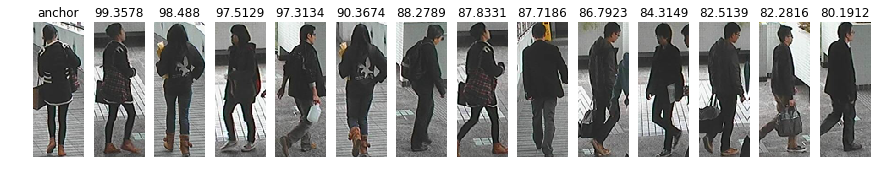

PID : 2
[1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


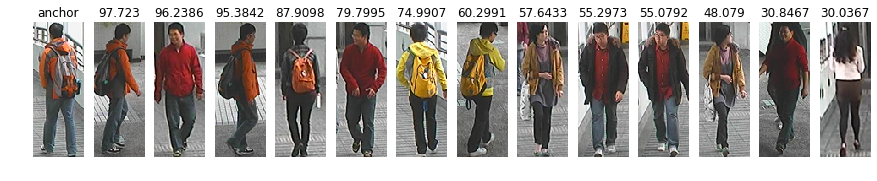

PID : 3
[0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


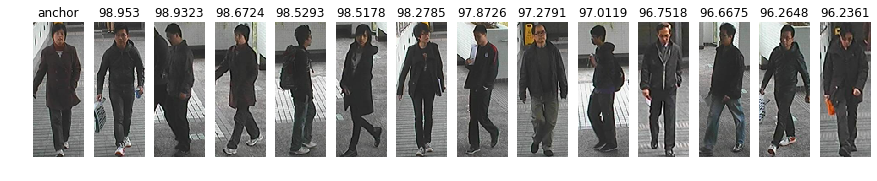

PID : 4
[0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0]


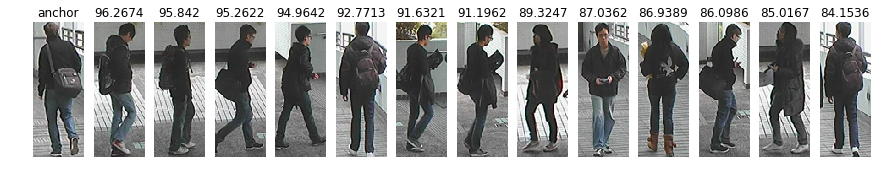

PID : 5
[0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


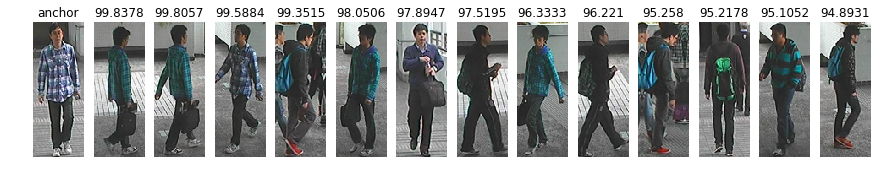

PID : 6
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


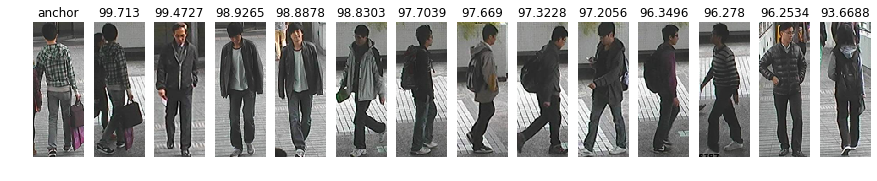

PID : 7
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0]


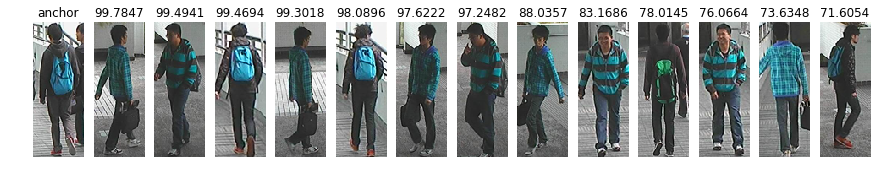

PID : 8
[0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0]


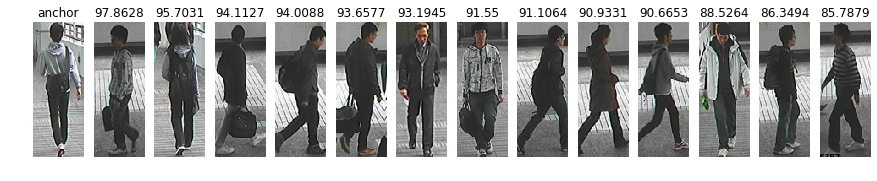

PID : 9
[0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0]


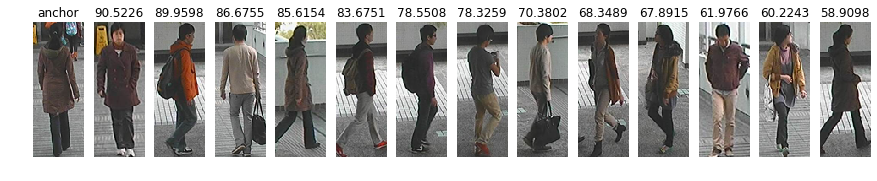

PID : 10
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


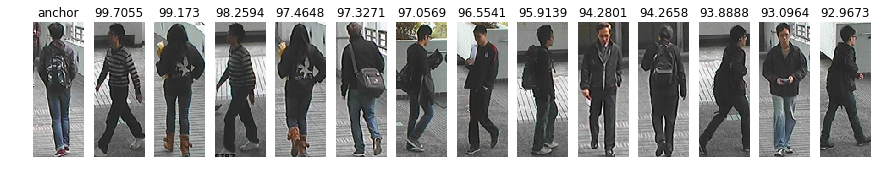

PID : 11
[0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0]


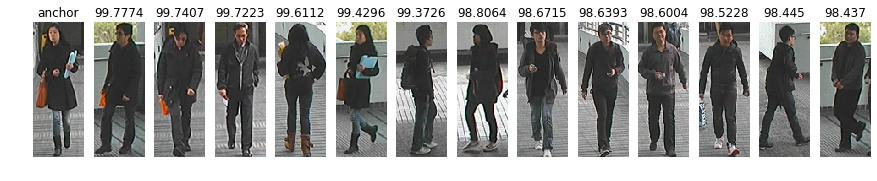

PID : 12
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


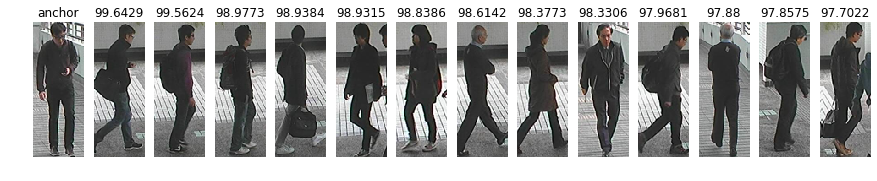

PID : 13
[0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


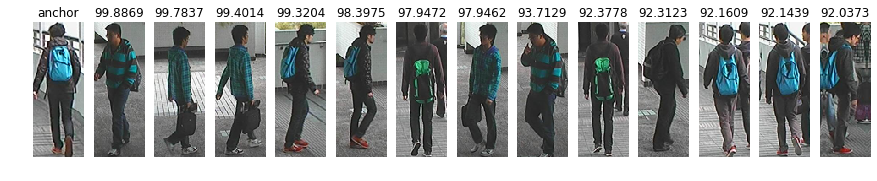

PID : 14
[0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0]


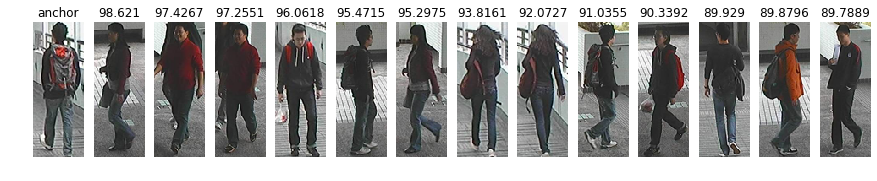

PID : 15
[0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


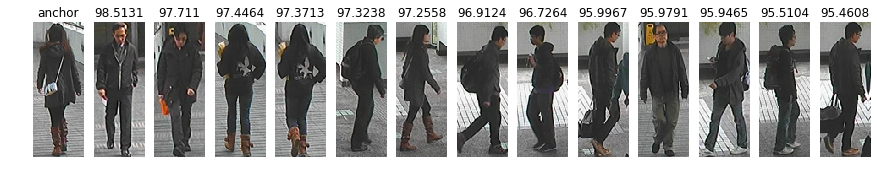

PID : 16
[0 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0]


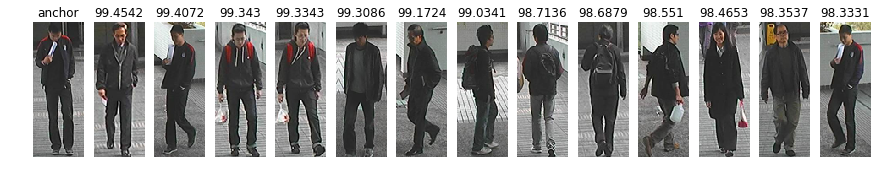

PID : 17
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


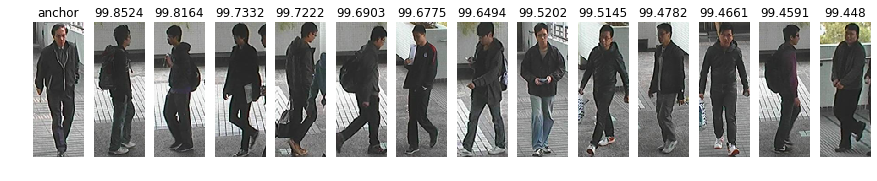

PID : 18
[1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


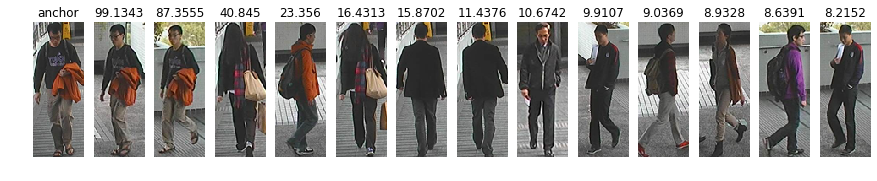

PID : 19
[0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0]


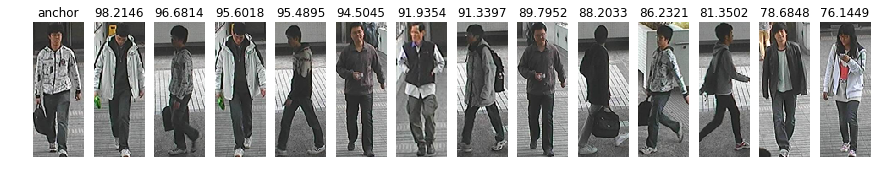

PID : 20
[0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


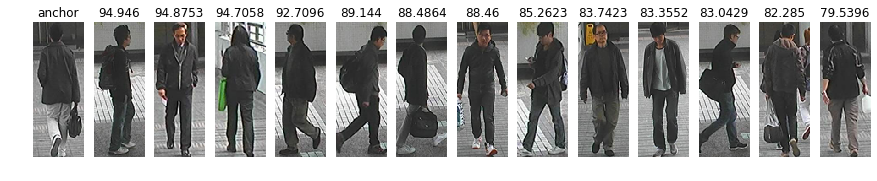

PID : 21
[0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


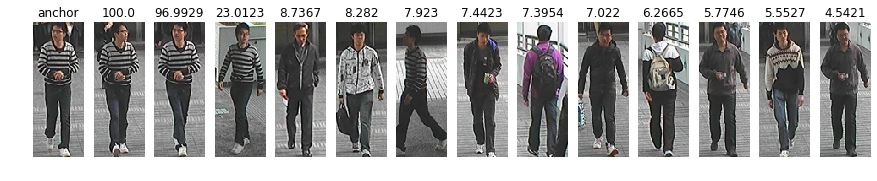

PID : 22
[1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


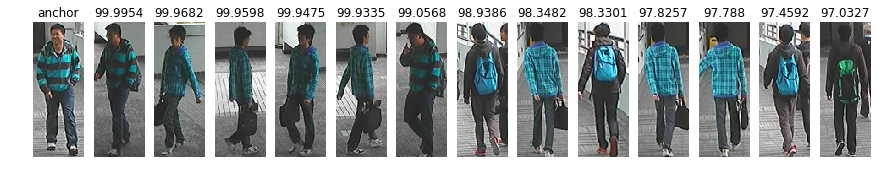

PID : 23
[0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


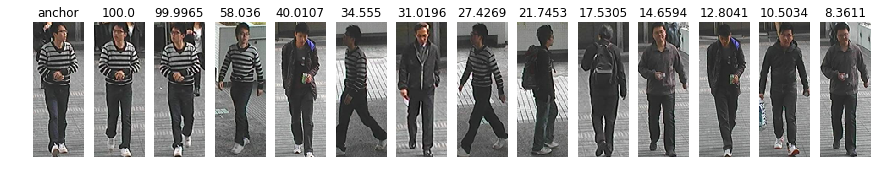

PID : 24
[0 0 0 1 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0]


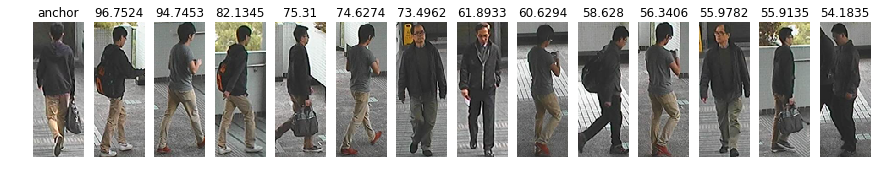

PID : 25
[0 0 0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0]


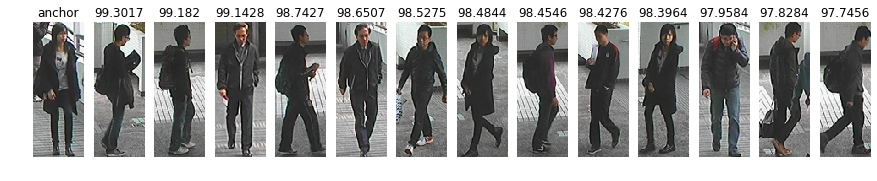

PID : 26
[0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0]


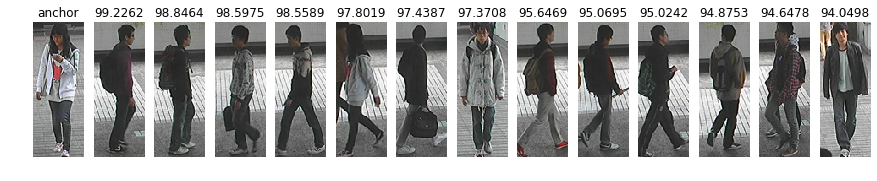

PID : 27
[0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0]


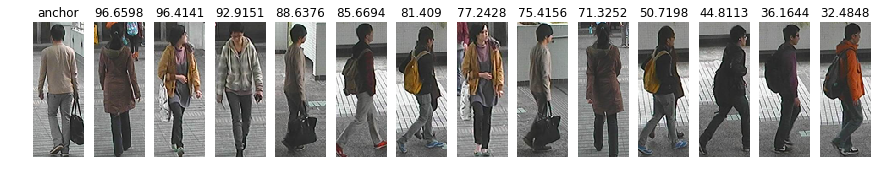

PID : 28
[1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0]


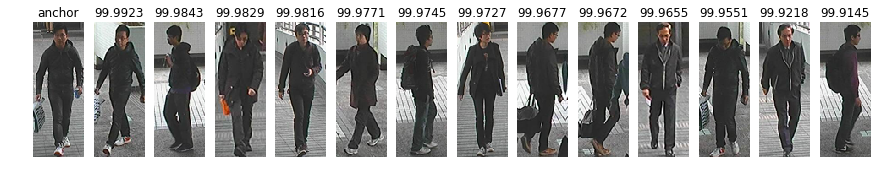

PID : 29
[0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0]


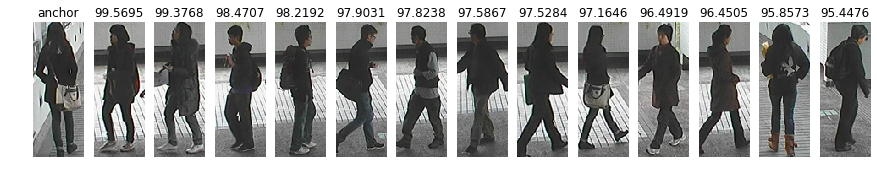

PID : 30
[0 0 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0]


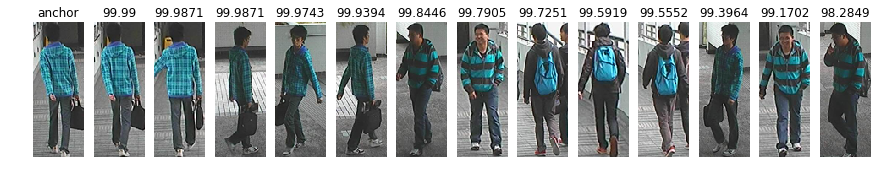

PID : 31
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


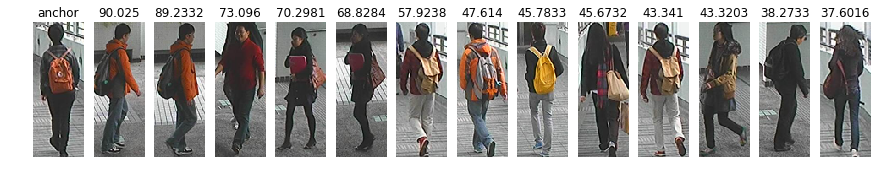

PID : 32
[0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0]


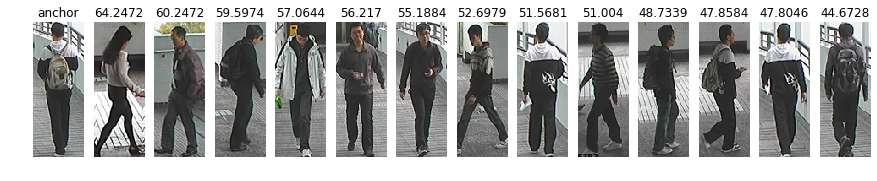

PID : 33
[0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


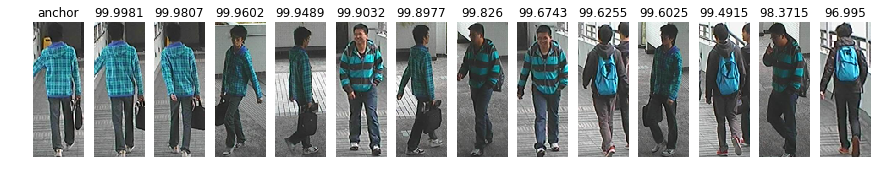

PID : 34
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


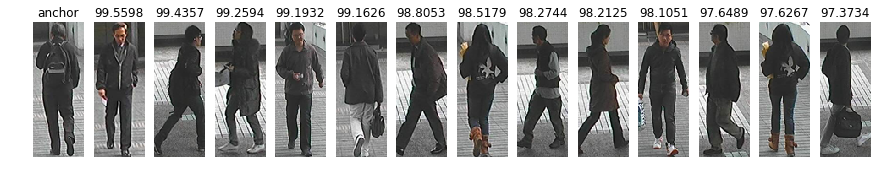

PID : 35
[0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


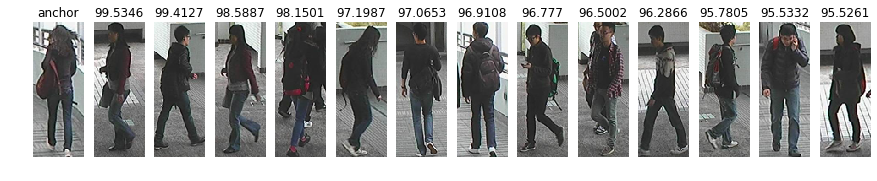

PID : 36
[0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


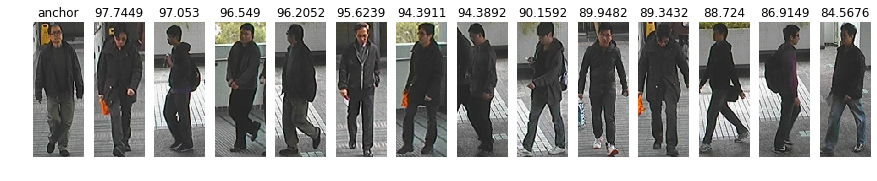

PID : 37
[0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1]


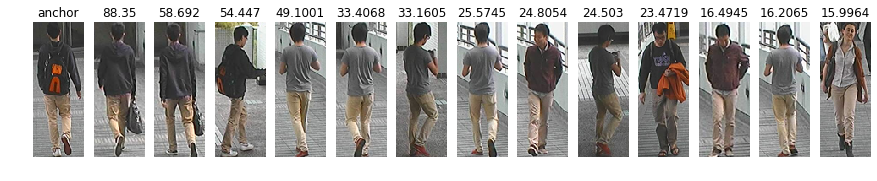

PID : 38
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


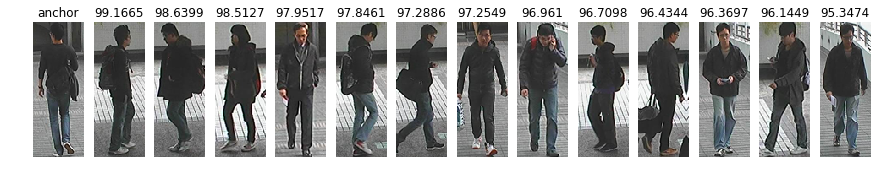

PID : 39
[0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


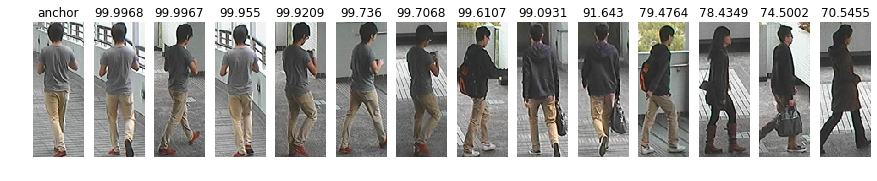

PID : 40
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0]


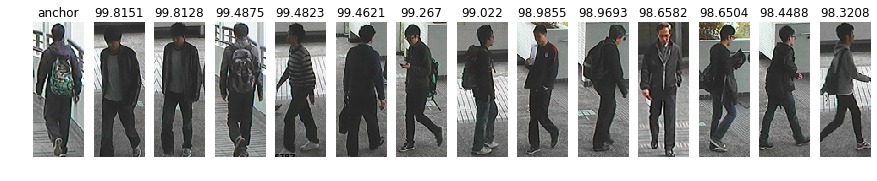

PID : 41
[1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


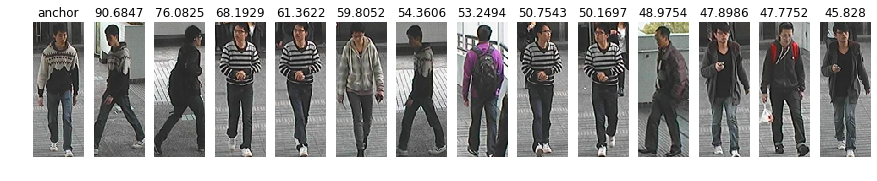

PID : 42
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


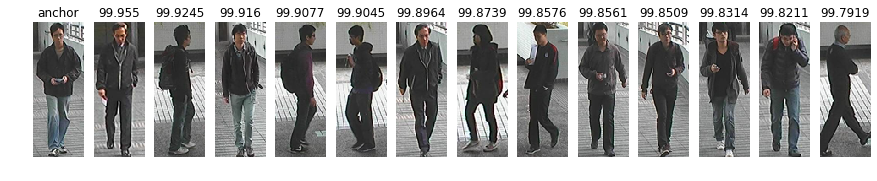

PID : 43
[0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0]


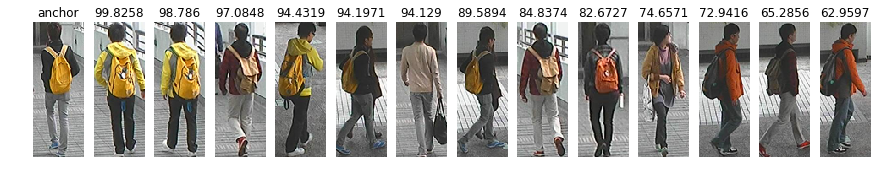

PID : 44
[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


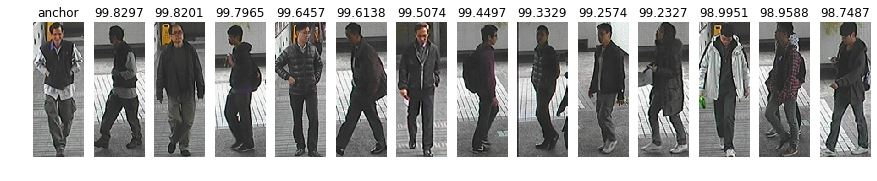

PID : 45
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


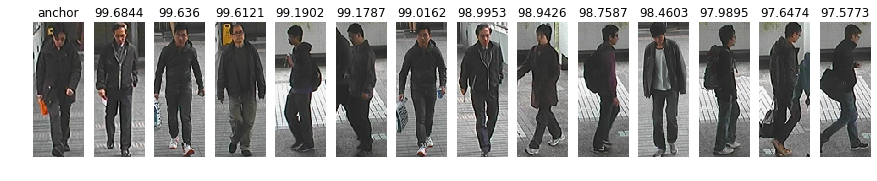

PID : 46
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


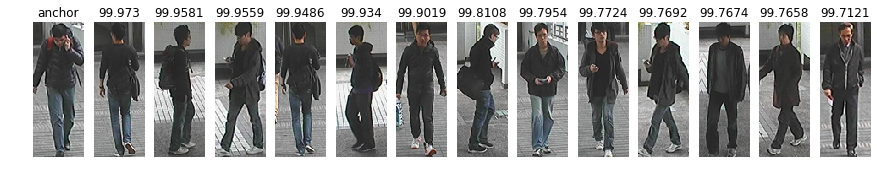

PID : 47
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


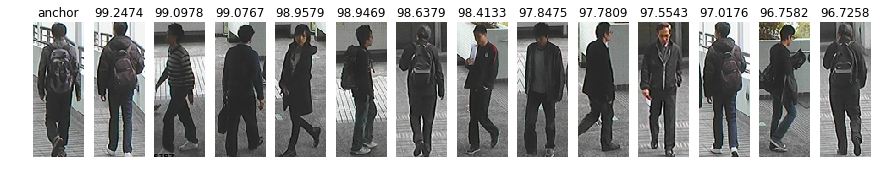

PID : 48
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


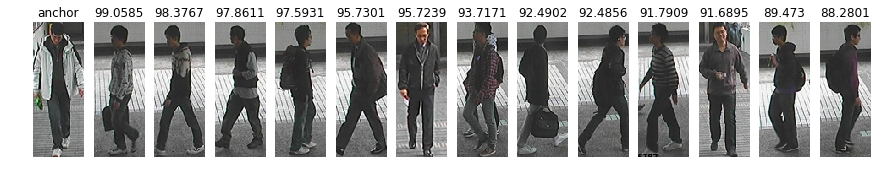

PID : 49
[1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


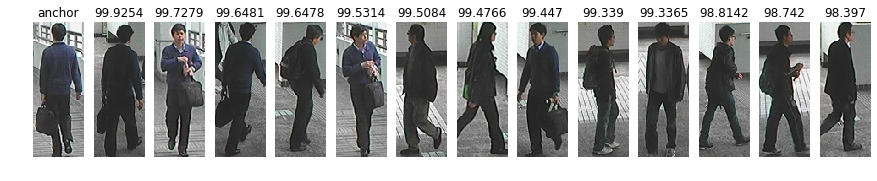

PID : 50
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 1]


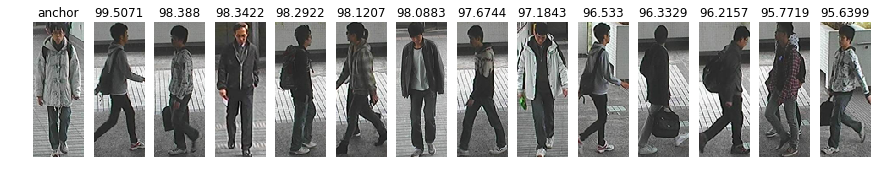

PID : 51
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0]


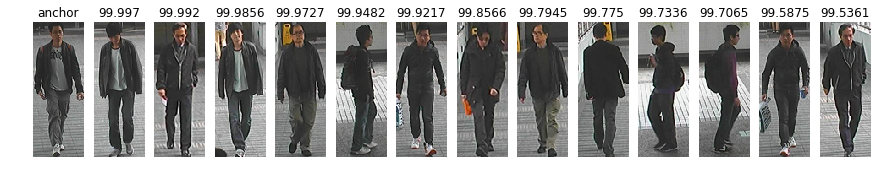

PID : 52
[1 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


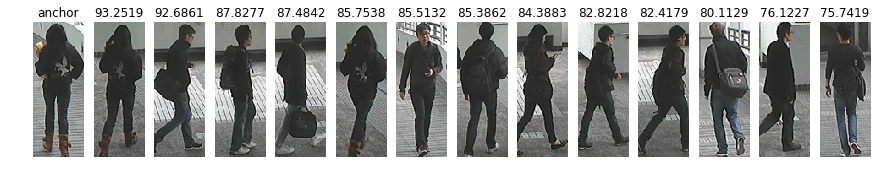

PID : 53
[1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


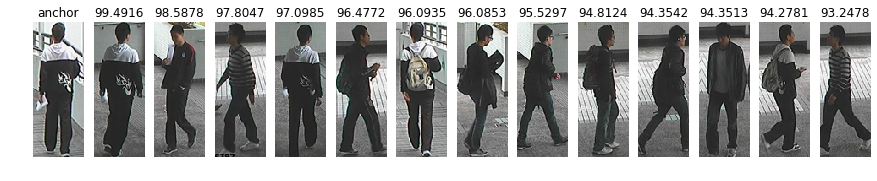

PID : 54
[1 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0]


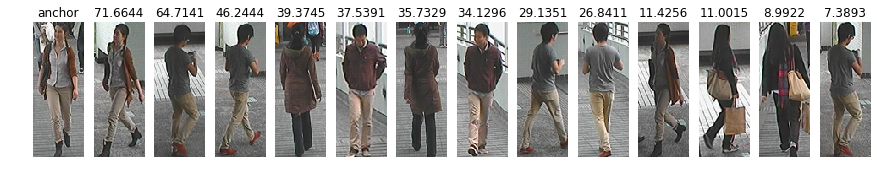

PID : 55
[0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0]


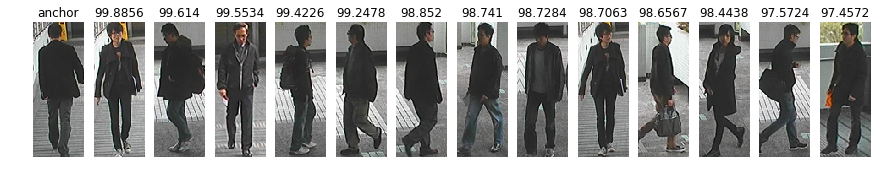

PID : 56
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


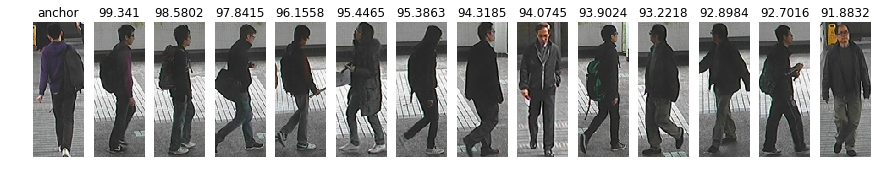

PID : 57
[0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0]


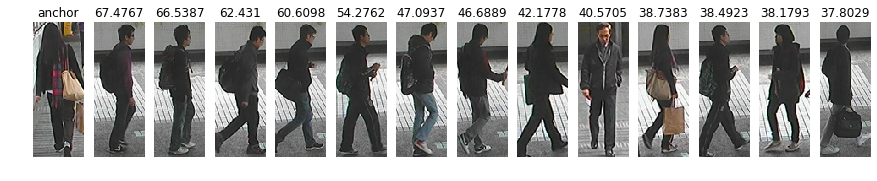

PID : 58
[0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0]


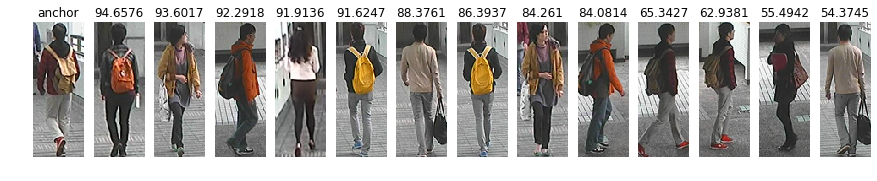

PID : 59
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0]


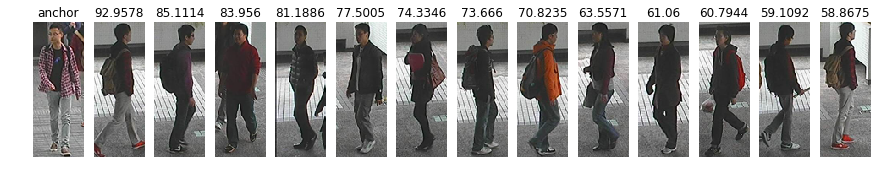

PID : 60
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


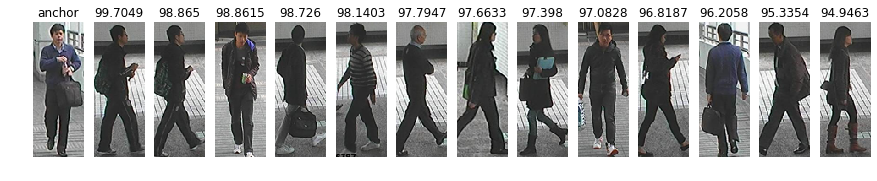

PID : 61
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


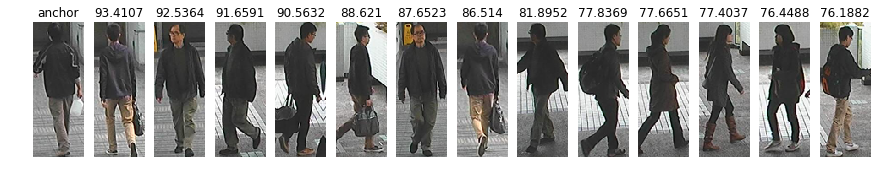

PID : 62
[0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0]


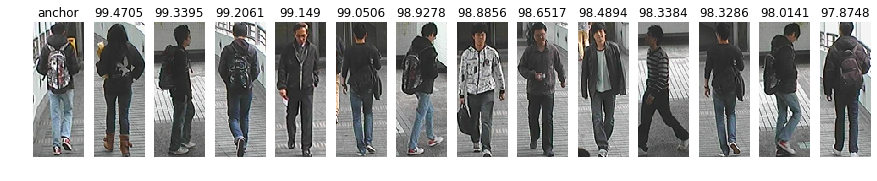

PID : 63
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


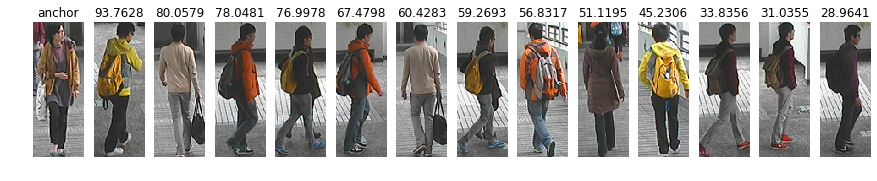

PID : 64
[0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


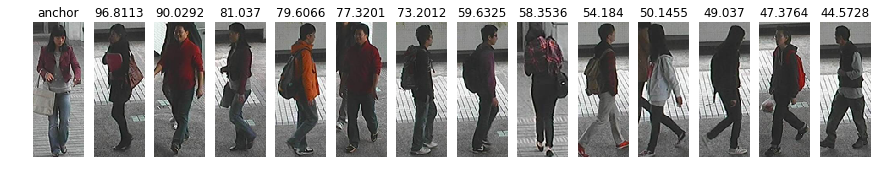

PID : 65
[0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0]


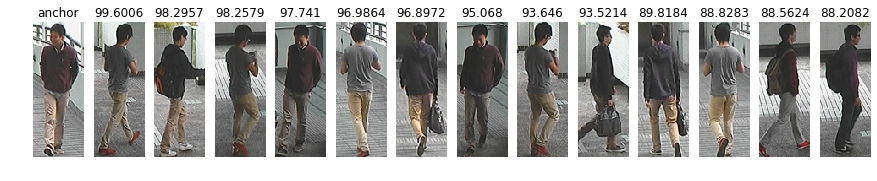

PID : 66
[0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


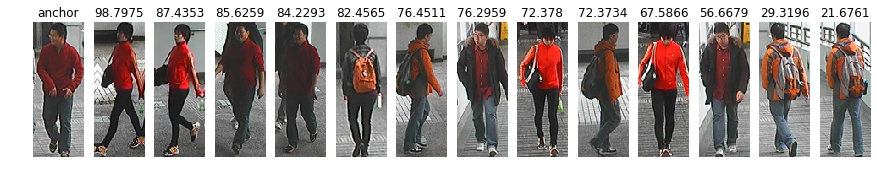

PID : 67
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


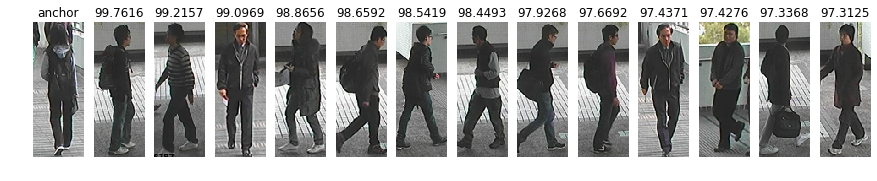

PID : 68
[0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


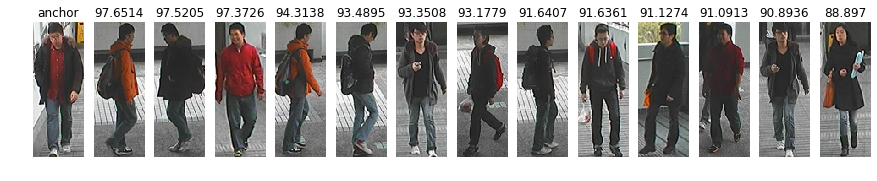

PID : 69
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


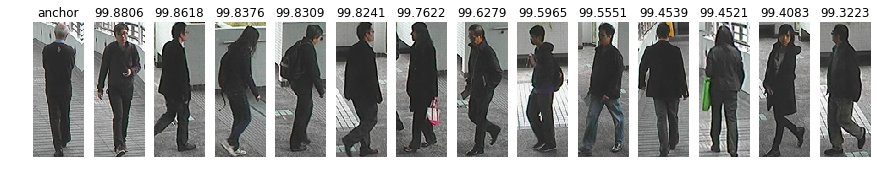

PID : 70
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


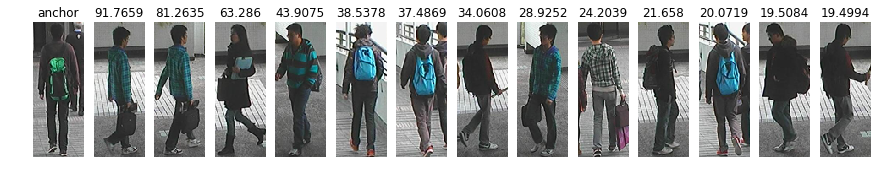

PID : 71
[1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


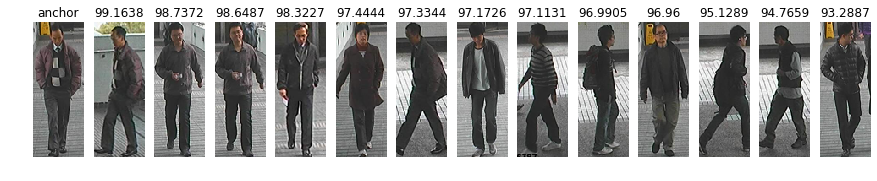

PID : 72
[0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0]


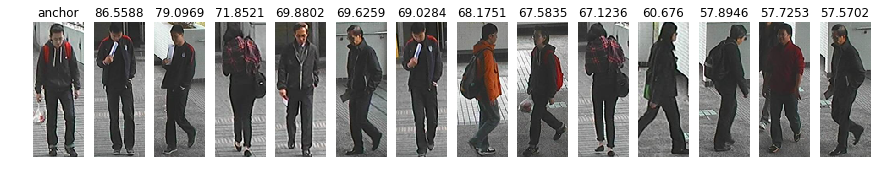

PID : 73
[0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


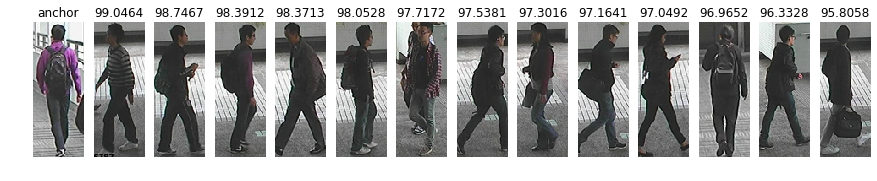

PID : 74
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


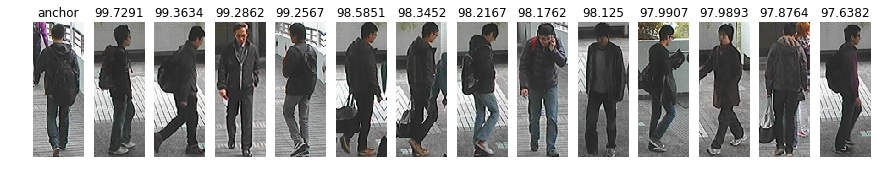

PID : 75
[0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0]


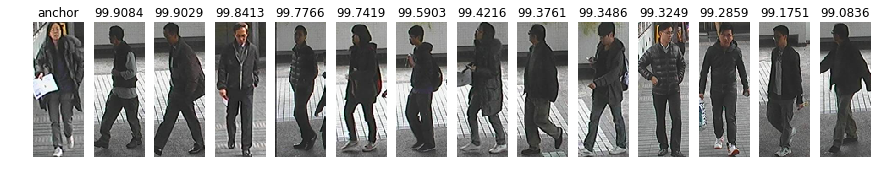

PID : 76
[0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0]


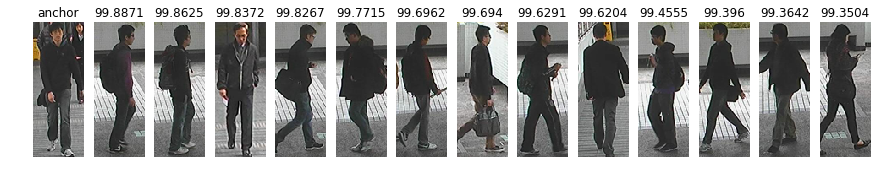

PID : 77
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0]


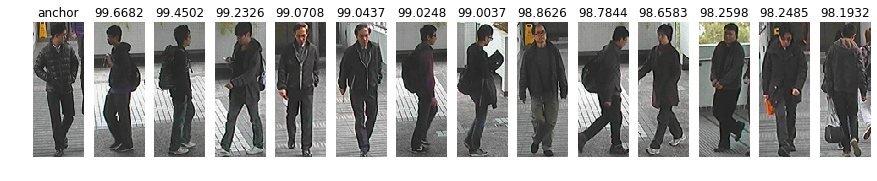

PID : 78
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


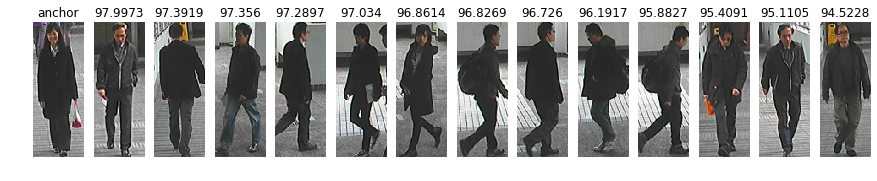

PID : 79
[0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


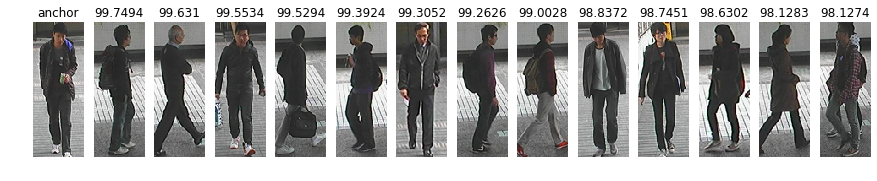

PID : 80
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


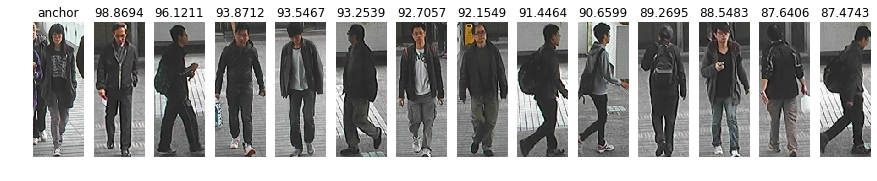

PID : 81
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


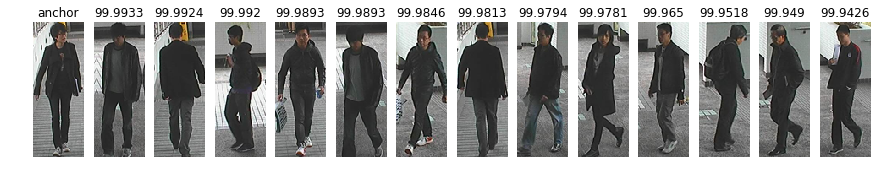

PID : 82
[0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


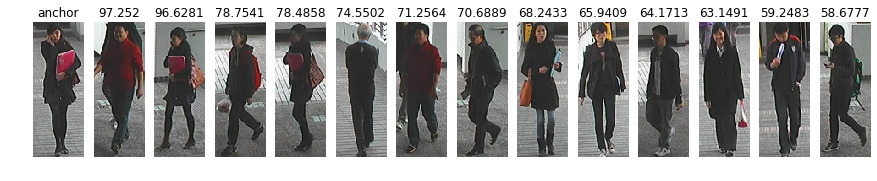

PID : 83
[0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0]


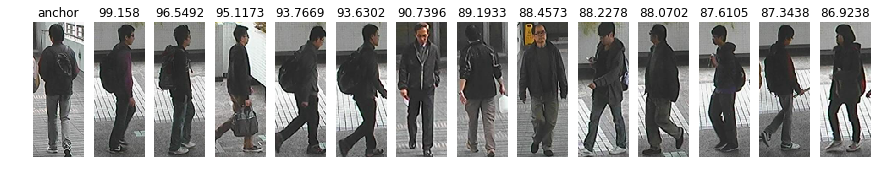

PID : 84
[0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 1 0 0 0 0]


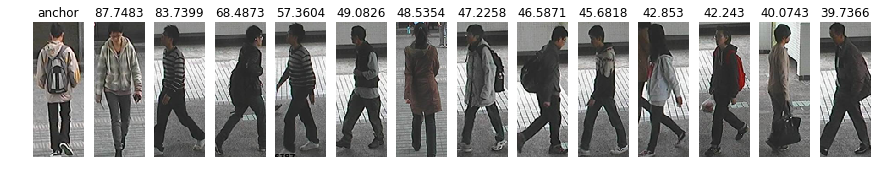

PID : 85
[1 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


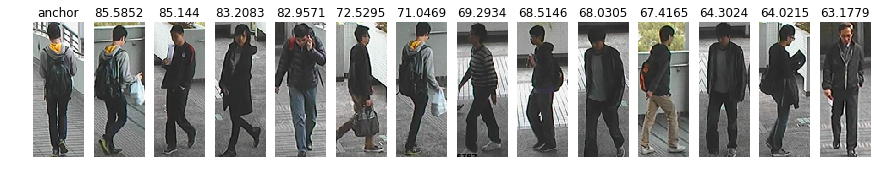

PID : 86
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


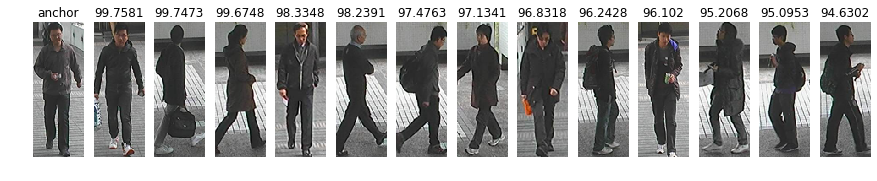

PID : 87
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0]


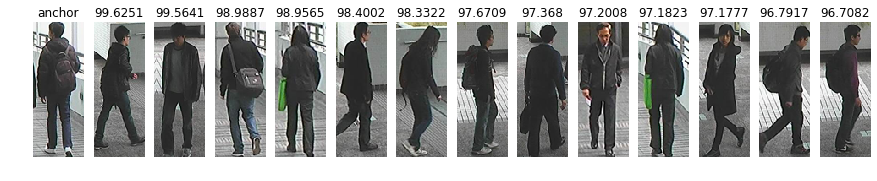

PID : 88
[0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


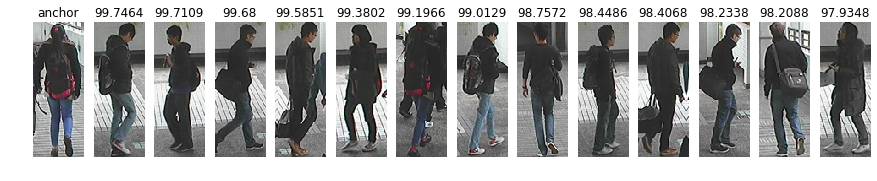

PID : 89
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1]


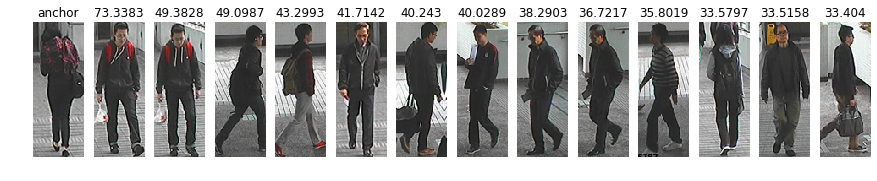

PID : 90
[0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0]


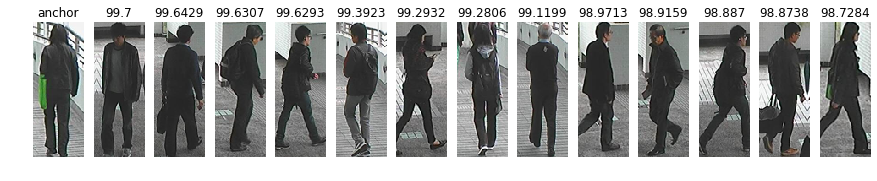

PID : 91
[0 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


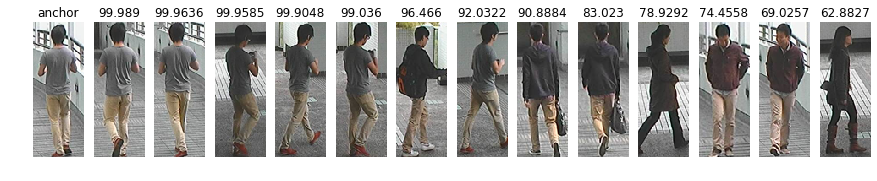

PID : 92
[0 0 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0]


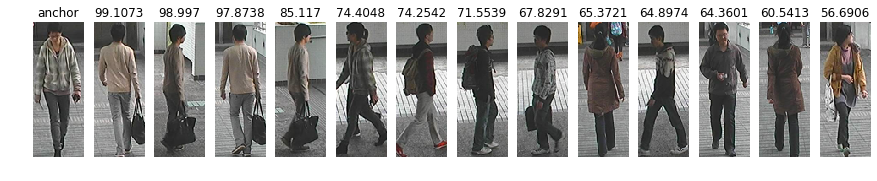

PID : 93
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1]


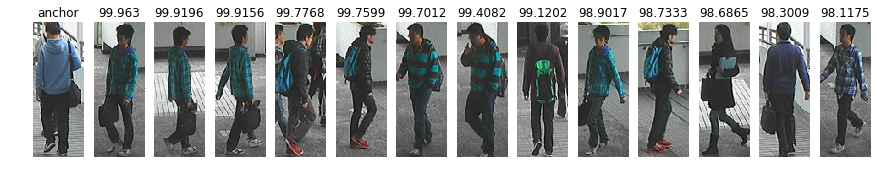

PID : 94
[0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 1 0]


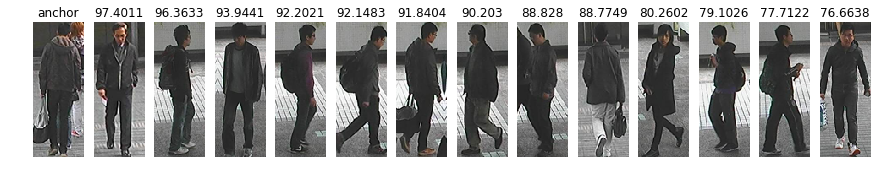

PID : 95
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1]


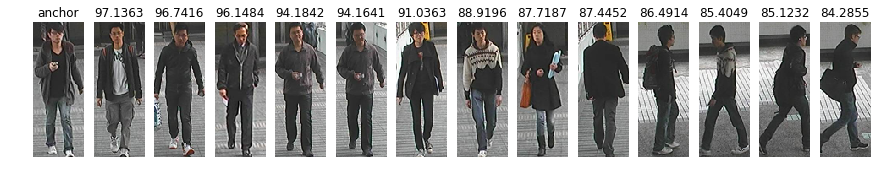

PID : 96
[1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


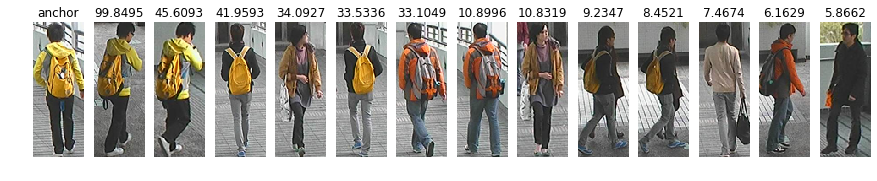

PID : 97
[0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 0 0 0]


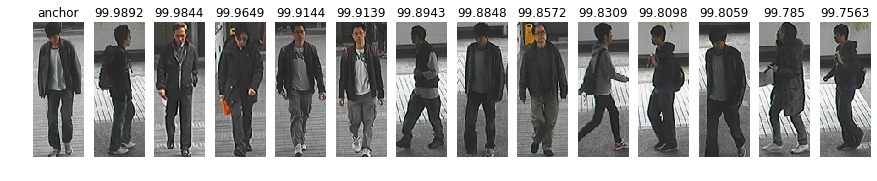

PID : 98
[1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


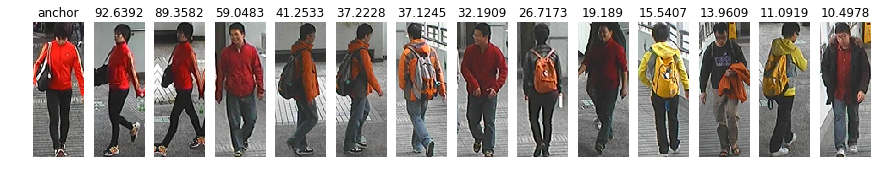

PID : 99
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


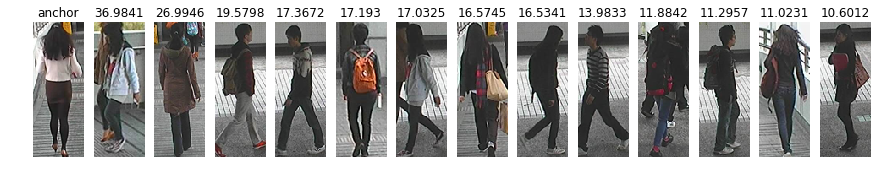

PID : 100
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


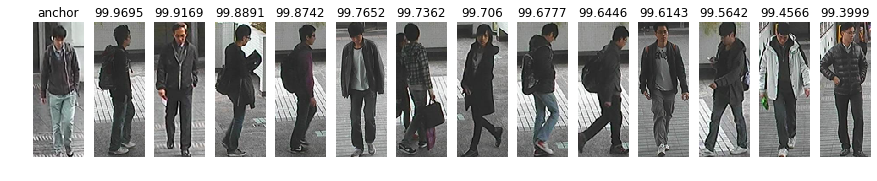

rank = 1 accuarcy is : 16
rank = 5 accuarcy is : 46
rank = 10 accuarcy is : 60
rank = 20 accuarcy is : 75


In [8]:
display = True

data_x_size = 160
data_y_size = 60

start_point = 0

batch_limit = 500
batch = [0, 0, 0] # start, end, length
total_batch = 0
change = temp1[0]
order = 1

rank = []
rank_index = []
total_result = []
rank_accuracy = np.empty((pick_person,20),dtype=int)

for i in range(len(temp1)):
    
    if change == temp1[i] and i+1 != len(temp1) and (i-batch[0]) < batch_limit:
        continue
        
    change = temp1[i]
    batch[1] = i
    batch[2] = batch[1]-batch[0]
    
    if i+1 == len(temp1):
        batch[1] += 1
        batch[2] += 1
        
    img1 = np.empty((batch[2], data_x_size, data_y_size, 3),dtype='uint8')
    img2 = np.empty((batch[2], data_x_size, data_y_size, 3),dtype='uint8')
    result = np.empty(batch[2],dtype=int)
       
    for j in range(0,batch[2]):
        img1[j,:,:,:] = cv2.resize(cv2.imread(temp_dir+'/'+temp_list[temp1[batch[0]+j]],cv2.IMREAD_COLOR),(data_y_size,data_x_size))
        img2[j,:,:,:] = cv2.resize(cv2.imread(temp_dir+'/'+temp_list[temp2[batch[0]+j]],cv2.IMREAD_COLOR),(data_y_size,data_x_size))
        result[j] = temp_CoN[batch[0]+j,1]
    batch[0] = i
    
    answer = tf.nn.softmax(model)
    #answer = tf.transpose(answer,[1, 0, 2])
    #answer= tf.reduce_mean(answer, axis=1)
    answer = sess.run(answer,feed_dict={X1:img1, X2:img2, batch_prob : False})
    rank.extend(answer[:,1])
    total_result.extend(result)
    
    if temp1[i] == temp1[i-1] and i+1 != len(temp1): continue
    
    rank = np.array(rank)
    total_result = np.array(total_result)
    rank_index = np.argsort(rank)
    ranking = np.round((rank[rank_index[::-1]]*100),4)
    
    print("PID :",order)
    
    total_result = total_result[rank_index[::-1]][:20]
    rank_accuracy[order-1,:] = total_result
    print(total_result)
    
    order += 1
    
    if display:
        fig , ax = plt.subplots(1, 14, figsize=(15,15))
        ax[0].set_axis_off()
        ax[0].imshow(cv2.cvtColor(img1[0], cv2.COLOR_BGR2RGB))
        ax[0].set_title("anchor")
        for j in range(1,14):
            ax[j].set_axis_off()
            compare_image = cv2.resize(cv2.imread(temp_dir+'/'+temp_list[temp2[start_point+rank_index[-j]]],cv2.IMREAD_COLOR),
                                                                                       (data_y_size,data_x_size))
            #ax[j].imshow(cv2.cvtColor(img2[rank_index[-j]], cv2.COLOR_BGR2RGB))
            ax[j].imshow(cv2.cvtColor(compare_image, cv2.COLOR_BGR2RGB))
            ax[j].set_title(ranking[j])
        plt.show()
        plt.close(fig)
    
    rank = []
    rank_index = []
    total_result = []
    start_point = i

print("rank = 1 accuarcy is :",rank_accuracy[:,0].sum(axis=0))
print("rank = 5 accuarcy is :",(rank_accuracy[:,:5].sum(axis=1)>0).astype(int).sum(axis=0))
print("rank = 10 accuarcy is :",(rank_accuracy[:,:10].sum(axis=1)>0).astype(int).sum(axis=0))
print("rank = 20 accuarcy is :",(rank_accuracy[:,:20].sum(axis=1)>0).astype(int).sum(axis=0))

In [ ]:
sess.close()

In [6]:
inception_v2_ac = []
inception_v2_ac.append(rank_accuracy[:,0].sum(axis=0))
for i in range(1,20):
    inception_v2_ac.append((rank_accuracy[:,:i].sum(axis=1)>0).astype(int).sum(axis=0))
print(inception_v2_ac)

[89, 89, 93, 95, 96, 97, 97, 97, 98, 98, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99]


In [2]:
batch_ac = [60, 60, 73, 79, 84, 89, 92, 94, 95, 95, 96, 96, 97, 97, 97, 97, 97, 98, 98, 98]
inception_ac = [89, 89, 93, 95, 96, 97, 97, 97, 98, 98, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99]
inception_v2_ac = [87, 87, 92, 97, 98, 99, 99, 99, 99, 99, 99, 99, 99, 99, 100, 100, 100, 100, 100, 100]
sp3_ac = [88, 88, 94, 97, 98, 98, 98, 98, 98, 98, 98, 99, 99, 99, 99, 99, 99, 100, 100, 100]

In [6]:
batch_ac = [35, 35, 47, 55, 58, 60, 61, 61, 61, 64, 69, 69, 70, 71, 73, 75, 75, 76, 78, 79]
inception_ac = [57, 57, 68, 70, 74, 76, 77, 79, 81, 83, 84, 84, 84, 85, 85, 85, 87, 87, 87, 87]
inception_v2_ac = [58, 58, 65, 68, 74, 75, 81, 81, 82, 82, 83, 84, 84, 88, 90, 90, 90, 90, 91, 91]
sp3_ac = [56, 56, 67, 67, 69, 71, 73, 74, 74, 75, 75, 75, 76, 77, 77, 77, 77, 77, 77, 77]

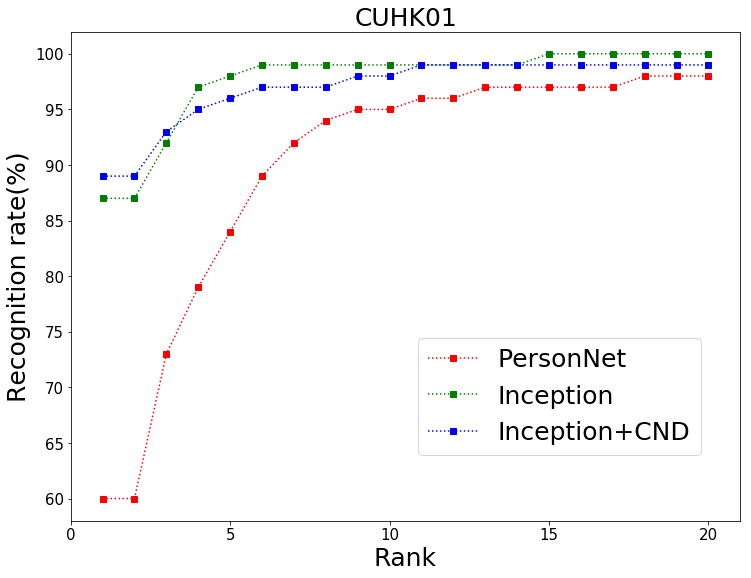

In [38]:
plt.figure(figsize=(12, 9))
plt.plot(range(1,21),batch_ac,'rs:',label="PersonNet")
plt.plot(range(1,21),inception_v2_ac,'gs:',label="Inception")
plt.plot(range(1,21),inception_ac,'bs:',label="Inception+CND")
plt.xlim(0,21)
plt.xticks(range(0,21,5), fontsize = 15)
plt.yticks(fontsize = 15)
plt.xlabel('Rank', fontsize = 25)
plt.ylabel('Recognition rate(%)', fontsize = 25)
plt.legend(loc=2,bbox_to_anchor=(0.5, 0.4), fontsize = 25)
plt.title("CUHK01", fontsize = 25)

fig = plt.gcf()
plt.show()

fig.savefig('CUHK01_result_ori.png', format = 'png')

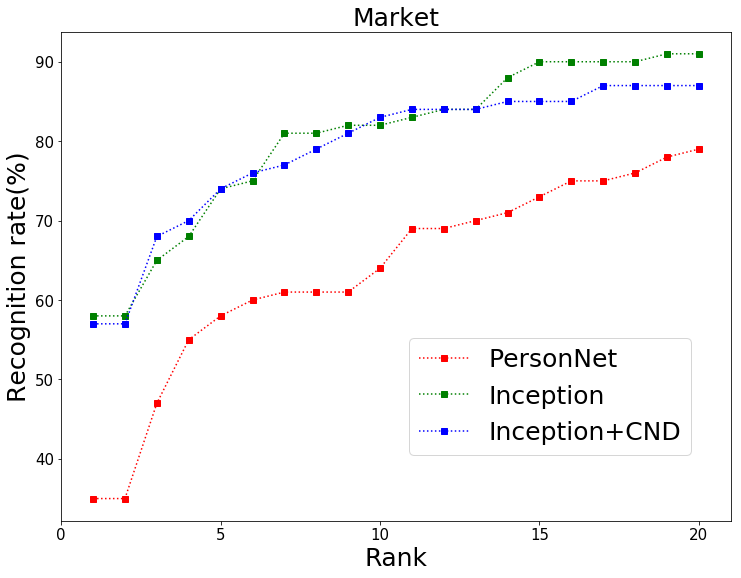

In [47]:
plt.figure(figsize=(12, 9))
plt.plot(range(1,21),batch_ac,'rs:',label="PersonNet")
plt.plot(range(1,21),inception_v2_ac,'gs:',label="Inception")
plt.plot(range(1,21),inception_ac,'bs:',label="Inception+CND")
plt.xlim(0,21)
plt.xticks(range(0,21,5), fontsize = 15)
plt.yticks(fontsize = 15)
plt.xlabel('Rank', fontsize = 25)
plt.ylabel('Recognition rate(%)', fontsize = 25)
plt.legend(loc=2,bbox_to_anchor=(0.5, 0.4), fontsize = 25)
plt.title("Market", fontsize = 25)


fig = plt.gcf()
plt.show()

fig.savefig('Market_result_ori.png', format = 'png')

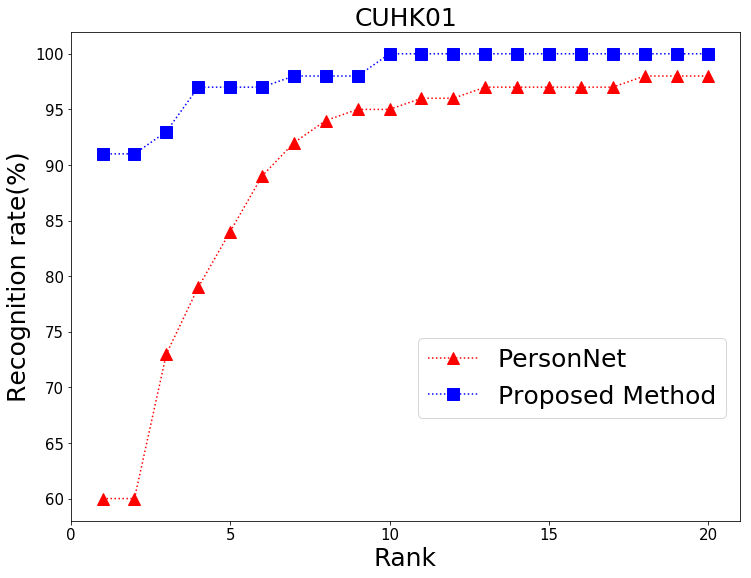

In [5]:
plt.figure(figsize=(12, 9))
plt.plot(range(1,21),batch_ac,'r^:',markersize=12,label="PersonNet")
#plt.plot(range(1,21),inception_v2_ac,'gs:',label="Inception")
#plt.plot(range(1,21),inception_ac,'bs:',label="Inception+CND")
plt.plot(range(1,21),sp3_1_ch,'bs:',markersize=12,label="Proposed Method")
plt.xlim(0,21)
plt.xticks(range(0,21,5), fontsize = 15)
plt.yticks(fontsize = 15)
plt.xlabel('Rank', fontsize = 25)
plt.ylabel('Recognition rate(%)', fontsize = 25)
plt.legend(loc=2,bbox_to_anchor=(0.5, 0.4), fontsize = 25)
plt.title("CUHK01", fontsize = 25)

fig = plt.gcf()
plt.show()

fig.savefig('CUHK01_result_add.png', format = 'png')

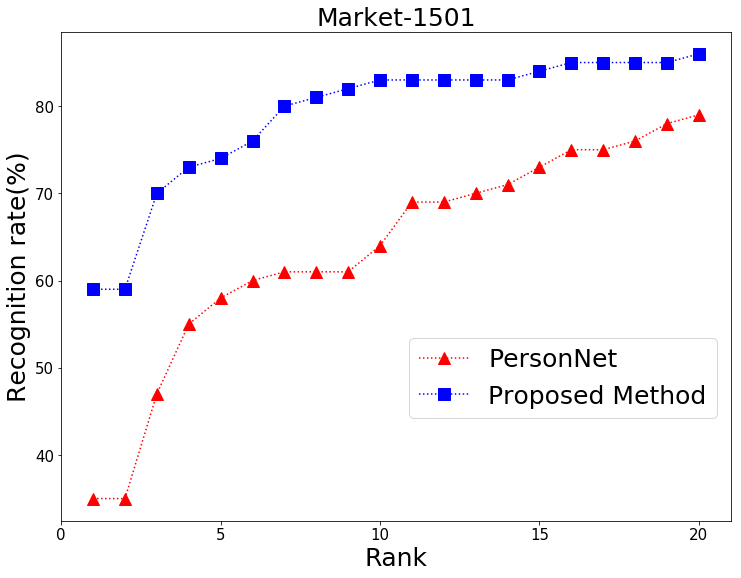

In [7]:
plt.figure(figsize=(12, 9))
plt.plot(range(1,21),batch_ac,'r^:',markersize=12,label="PersonNet")
#plt.plot(range(1,21),inception_v2_ac,'gs:',label="Inception")
#plt.plot(range(1,21),inception_ac,'bs:',label="Inception+CND")
plt.plot(range(1,21),sp3_3_mk,'bs:',markersize=12,label="Proposed Method")
plt.xlim(0,21)
plt.xticks(range(0,21,5), fontsize = 15)
plt.yticks(fontsize = 15)
plt.xlabel('Rank', fontsize = 25)
plt.ylabel('Recognition rate(%)', fontsize = 25)
plt.legend(loc=2,bbox_to_anchor=(0.5, 0.4), fontsize = 25)
plt.title("Market-1501", fontsize = 25)

fig = plt.gcf()
plt.show()

fig.savefig('Market_result_add.png', format = 'png')

In [3]:
sp3_1_mk = [55, 55, 63, 66, 68, 70, 73, 74, 75, 77, 78, 78, 79, 79, 79, 80, 80, 80, 80, 81]
sp3_2_mk = [60, 60, 67, 70, 71, 71, 75, 75, 77, 78, 78, 78, 79, 80, 83, 83, 86, 88, 89, 89]
sp3_3_mk = [59, 59, 70, 73, 74, 76, 80, 81, 82, 83, 83, 83, 83, 83, 84, 85, 85, 85, 85, 86]

sp3_1_ch = [91, 91, 93, 97, 97, 97, 98, 98, 98, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100]
sp3_2_ch = [85, 85, 92, 96, 97, 98, 98, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99]
sp3_3_ch = [86, 86, 94, 96, 97, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99]

sp5_1_mk = [51, 51, 59, 65, 69, 70, 72, 74, 75, 77, 78, 78, 79, 81, 81, 83, 83, 84, 85, 85]
sp5_2_mk = [53, 53, 59, 64, 67, 70, 73, 75, 75, 76, 77, 80, 81, 81, 81, 81, 81, 83, 83, 83]
sp5_3_mk = [44, 44, 52, 59, 66, 71, 72, 76, 77, 77, 77, 77, 80, 80, 81, 82, 82, 82, 82, 82]
sp5_4_mk = [50, 50, 60, 67, 70, 76, 77, 78, 79, 79, 79, 80, 80, 81, 82, 84, 84, 85, 85, 85]
sp5_5_mk = [49, 49, 61, 66, 72, 78, 78, 80, 81, 82, 82, 83, 83, 84, 84, 84, 84, 85, 85, 85]

sp5_1_ch = [86, 86, 90, 94, 95, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 98, 98, 98, 98]
sp5_2_ch = [83, 83, 92, 93, 94, 95, 95, 97, 99, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100]
sp5_3_ch = [78, 78, 89, 92, 93, 93, 94, 95, 95, 95, 96, 97, 97, 97, 97, 97, 97, 97, 98, 99]
sp5_4_ch = [86, 86, 91, 96, 97, 97, 97, 98, 98, 98, 99, 99, 99, 99, 99, 99, 99, 99, 100, 100]
sp5_5_ch = [82, 82, 92, 94, 96, 98, 98, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99]

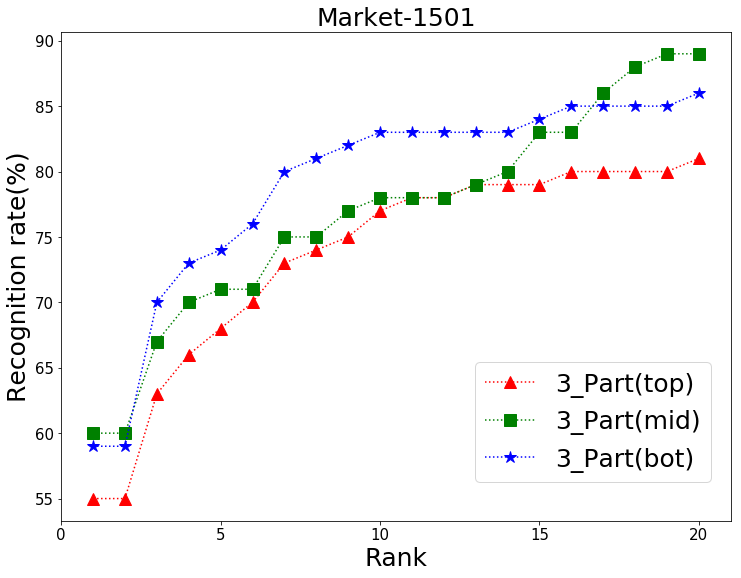

In [22]:
plt.figure(figsize=(12, 9))
plt.plot(range(1,21),sp3_1_mk,'r^:',markersize=12,label="3_Part(top)")
plt.plot(range(1,21),sp3_2_mk,'gs:',markersize=12,label="3_Part(mid)")
plt.plot(range(1,21),sp3_3_mk,'b*:',markersize=12,label="3_Part(bot)")
#plt.plot(range(1,21),inception_ac,'ms:',label="Inception+CND")
plt.xlim(0,21)
plt.xticks(range(0,21,5), fontsize = 15)
plt.yticks(fontsize = 15)
plt.xlabel('Rank', fontsize = 25)
plt.ylabel('Recognition rate(%)', fontsize = 25)

plt.legend(loc=2,bbox_to_anchor=(0.6, 0.35), fontsize = 25)
plt.title("Market-1501", fontsize = 25)

fig = plt.gcf()
plt.show()

fig.savefig('Market_result_3p.png', format = 'png')

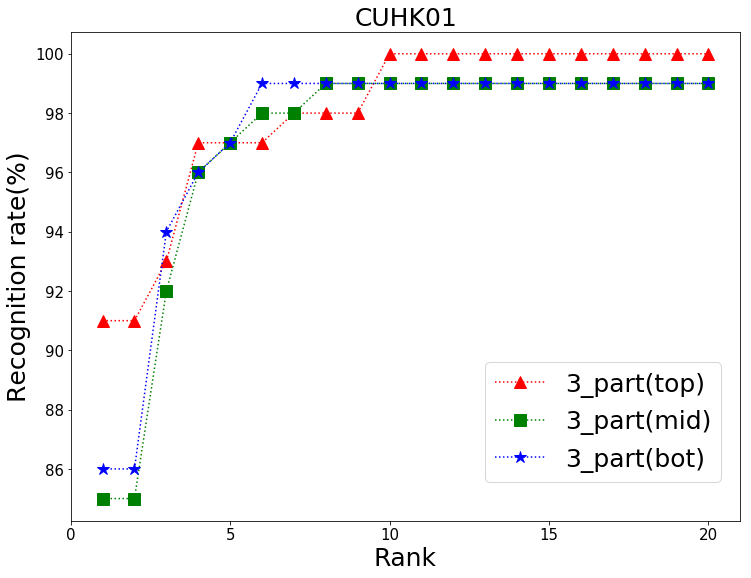

In [27]:
plt.figure(figsize=(12, 9))
plt.plot(range(1,21),sp3_1_ch,'r^:',markersize=12,label="3_part(top)")
plt.plot(range(1,21),sp3_2_ch,'gs:',markersize=12,label="3_part(mid)")
plt.plot(range(1,21),sp3_3_ch,'b*:',markersize=12,label="3_part(bot)")
plt.xlim(0,21)
plt.xticks(range(0,21,5), fontsize = 15)
plt.yticks(fontsize = 15)
plt.xlabel('Rank', fontsize = 25)
plt.ylabel('Recognition rate(%)', fontsize = 25)
plt.legend(loc=2,bbox_to_anchor=(0.6, 0.35), fontsize = 25)
plt.title("CUHK01", fontsize = 25)

fig = plt.gcf()
plt.show()

fig.savefig('CUHK01_result_3p.png', format = 'png')

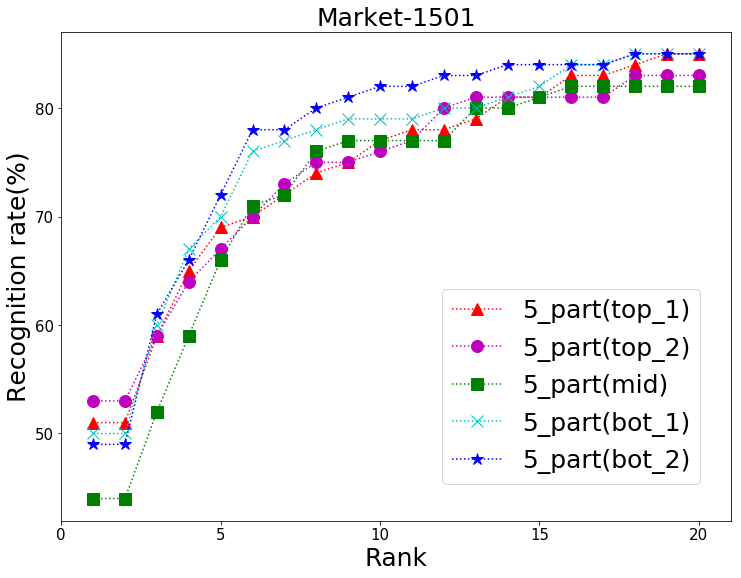

In [29]:
plt.figure(figsize=(12, 9))
plt.plot(range(1,21),sp5_1_mk,'r^:',markersize=12,label="5_part(top_1)")
plt.plot(range(1,21),sp5_2_mk,'mo:',markersize=12,label="5_part(top_2)")
plt.plot(range(1,21),sp5_3_mk,'gs:',markersize=12,label="5_part(mid)")
plt.plot(range(1,21),sp5_4_mk,'cx:',markersize=12,label="5_part(bot_1)")
plt.plot(range(1,21),sp5_5_mk,'b*:',markersize=12,label="5_part(bot_2)")
plt.xlim(0,21)
plt.xticks(range(0,21,5), fontsize = 15)
plt.yticks(fontsize = 15)
#plt.yticks(range(0,100,10))
plt.xlabel('Rank', fontsize = 25)
plt.ylabel('Recognition rate(%)', fontsize = 25)
plt.legend(loc=2,bbox_to_anchor=(0.55, 0.5), fontsize = 25)
plt.title("Market-1501", fontsize = 25)

fig = plt.gcf()
plt.show()

fig.savefig('Market_result_5p.png', format = 'png')

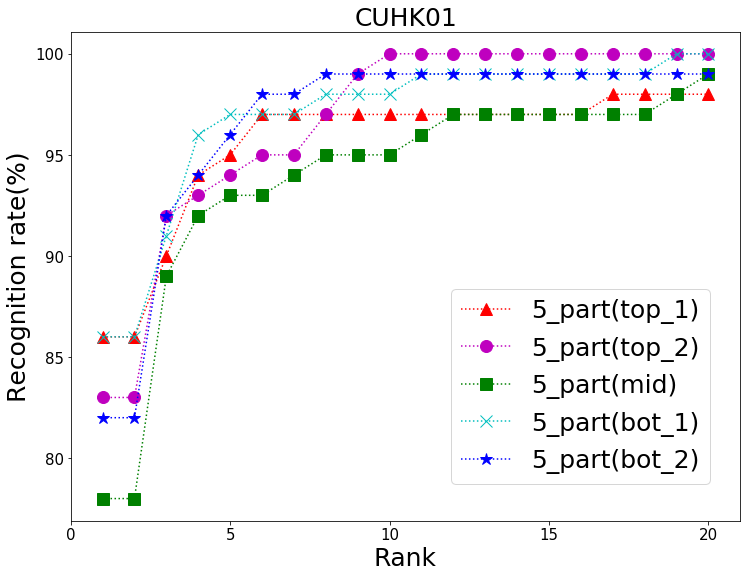

In [25]:
plt.figure(figsize=(12, 9))
plt.plot(range(1,21),sp5_1_ch,'r^:',markersize=12,label="5_part(top_1)")
plt.plot(range(1,21),sp5_2_ch,'mo:',markersize=12,label="5_part(top_2)")
plt.plot(range(1,21),sp5_3_ch,'gs:',markersize=12,label="5_part(mid)")
plt.plot(range(1,21),sp5_4_ch,'cx:',markersize=12,label="5_part(bot_1)")
plt.plot(range(1,21),sp5_5_ch,'b*:',markersize=12,label="5_part(bot_2)")
plt.xlim(0,21)
plt.xticks(range(0,21,5), fontsize = 15)
plt.yticks(fontsize = 15)
#plt.yticks(range(60,100,10))
plt.xlabel('Rank', fontsize = 25)
plt.ylabel('Recognition rate(%)', fontsize = 25)
plt.legend(loc=2,bbox_to_anchor=(0.55, 0.5), fontsize = 25)
plt.title("CUHK01", fontsize = 25)

fig = plt.gcf()
plt.show()

fig.savefig('CUHK01_result_5p.png', format = 'png')

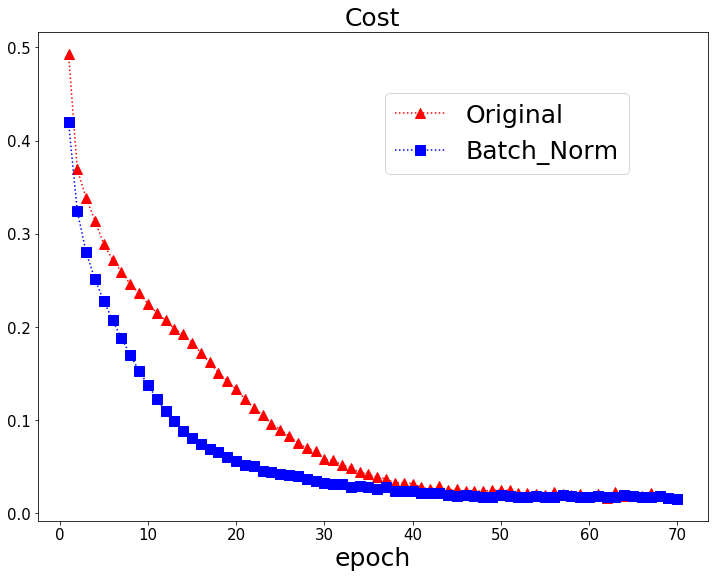

In [14]:
non_batch_loss = [0.493, 0.369, 0.338, 0.314, 0.289, 0.272, 0.259, 0.246, 0.236, 0.225, 0.215, 0.207, 0.198, 0.192, 0.183, 0.172, 0.162, 0.151, 0.142, 0.133, 0.123, 0.113, 0.106, 0.096, 0.090, 0.083, 0.076, 0.070, 0.067, 0.058, 0.057, 0.052, 0.049, 0.044, 0.042, 0.039, 0.037, 0.033, 0.033, 0.032, 0.028, 0.026, 0.029, 0.025, 0.026, 0.024, 0.024, 0.024, 0.025, 0.025, 0.025, 0.022, 0.022, 0.021, 0.020, 0.023, 0.021, 0.020, 0.021, 0.018, 0.021, 0.017, 0.023, 0.019, 0.019, 0.019, 0.022, 0.019, 0.017, 0.016]
batch_loss = [0.420, 0.324, 0.280, 0.251, 0.228, 0.207, 0.188, 0.170, 0.153, 0.138, 0.123, 0.110, 0.099, 0.088, 0.081, 0.074, 0.069, 0.066, 0.061, 0.056, 0.052, 0.051, 0.046, 0.045, 0.042, 0.041, 0.040, 0.037, 0.035, 0.033, 0.032, 0.032, 0.028, 0.029, 0.028, 0.026, 0.028, 0.024, 0.024, 0.024, 0.022, 0.022, 0.022, 0.020, 0.019, 0.020, 0.019, 0.018, 0.018, 0.020, 0.019, 0.018, 0.018, 0.019, 0.018, 0.018, 0.020, 0.019, 0.018, 0.018, 0.019, 0.018, 0.018, 0.020, 0.019, 0.018, 0.018, 0.019, 0.017, 0.016]

plt.figure(figsize=(12, 9))
plt.plot(range(1,71),non_batch_loss,'r^:',markersize=10,label="Original")
plt.plot(range(1,71),batch_loss,'bs:',markersize=10,label="Batch_Norm")
plt.xlabel('epoch', fontsize = 25)
plt.xticks(fontsize = 15)
plt.yticks(fontsize = 15)
plt.legend(loc=2,bbox_to_anchor=(0.5, 0.9), fontsize = 25)
plt.title("Cost", fontsize = 25)

fig = plt.gcf()
plt.show()

fig.savefig('cost.png', format = 'png')

In [4]:
# 3DPeS
ori_3DPeS = [13, 13, 22, 27, 31, 33, 36, 42, 49, 49, 49, 51, 55, 57, 59, 60, 61, 61, 61, 62]
sp3_1_3DPeS = [31, 31, 38, 46, 52, 52, 53, 56, 57, 59, 65, 66, 67, 71, 71, 71, 71, 71, 73, 73]
sp3_2_3DPeS = [13, 13, 20, 29, 32, 35, 36, 38, 39, 41, 43, 46, 46, 48, 50, 52, 55, 56, 56, 56]
sp3_3_3DPeS = [29, 29, 40, 45, 49, 51, 55, 58, 61, 62, 63, 65, 66, 66, 66, 69, 69, 70, 70, 71]

sp5_1_3DPeS = [5, 5, 9, 11, 16, 17, 19, 22, 25, 28, 30, 30, 30, 31, 31, 31, 32, 33, 35, 35]
sp5_2_3DPeS = [17, 17, 24, 32, 42, 50, 53, 53, 54, 57, 62, 64, 66, 66, 66, 66, 67, 69, 71, 71]
sp5_3_3DPeS = [18, 18, 25, 32, 37, 39, 42, 44, 49, 51, 51, 52, 53, 55, 56, 57, 57, 58, 59, 61]
sp5_4_3DPeS = [16, 16, 22, 28, 32, 34, 35, 36, 36, 36, 38, 38, 41, 41, 42, 43, 46, 46, 48, 49]
sp5_5_3DPeS = [20, 20, 28, 38, 42, 46, 49, 52, 53, 54, 57, 58, 60, 61, 61, 62, 63, 64, 66, 66]

In [5]:
# CUHK02
ori_CUHK02 = [49, 49, 63, 70, 74, 79, 81, 85, 85, 86, 88, 88, 90, 91, 91, 91, 91, 91, 91, 91]
sp3_1_CUHK02 = [62, 62, 74, 75, 79, 82, 82, 85, 87, 88, 90, 90, 91, 92, 92, 92, 93, 93, 94, 95]
sp3_2_CUHK02 = [38, 38, 50, 61, 66, 66, 68, 71, 73, 76, 77, 77, 78, 78, 80, 81, 81, 82, 82, 83]
sp3_3_CUHK02 = [53, 53, 66, 74, 79, 81, 82, 85, 87, 89, 89, 91, 91, 91, 91, 91, 91, 91, 91, 91]

sp5_1_CUHK02 = [5, 5, 9, 11, 16, 17, 19, 22, 25, 28, 30, 30, 30, 31, 31, 31, 32, 33, 35, 35]
sp5_2_CUHK02 = [17, 17, 24, 32, 42, 50, 53, 53, 54, 57, 62, 64, 66, 66, 66, 66, 67, 69, 71, 71]
sp5_3_CUHK02 = [18, 18, 25, 32, 37, 39, 42, 44, 49, 51, 51, 52, 53, 55, 56, 57, 57, 58, 59, 61]
sp5_4_CUHK02 = [16, 16, 22, 28, 32, 34, 35, 36, 36, 36, 38, 38, 41, 41, 42, 43, 46, 46, 48, 49]
sp5_5_CUHK02 = [20, 20, 28, 38, 42, 46, 49, 52, 53, 54, 57, 58, 60, 61, 61, 62, 63, 64, 66, 66]

In [6]:
# PKU
ori_PKU = [48, 48, 59, 70, 81, 88, 91, 93, 94, 95, 97, 97, 98, 98, 98, 98, 98, 98, 98, 98]
sp3_1_PKU = [45, 45, 56, 63, 71, 76, 76, 82, 84, 85, 86, 88, 89, 90, 90, 92, 92, 92, 92, 92]
sp3_2_PKU = [47, 47, 63, 72, 77, 79, 82, 85, 86, 88, 90, 90, 90, 90, 92, 92, 92, 93, 93, 93]
sp3_3_PKU = [55, 55, 66, 73, 77, 82, 86, 86, 90, 91, 92, 92, 93, 94, 94, 94, 94, 94, 95, 97]


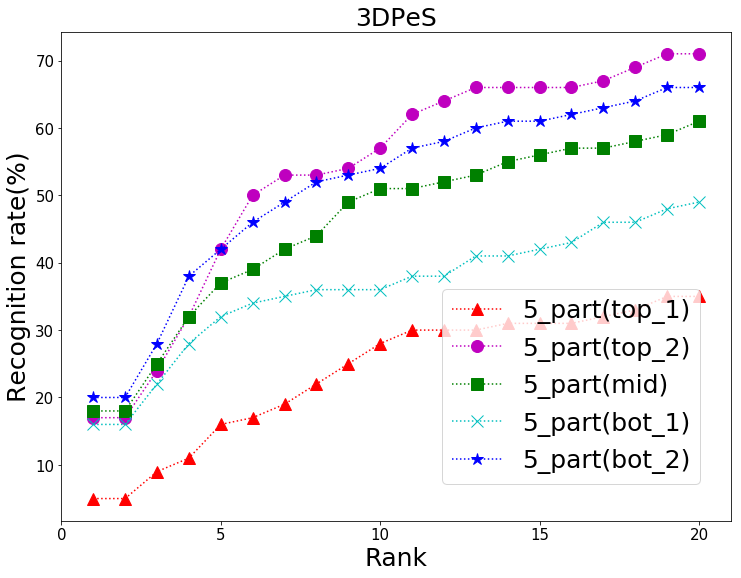

In [7]:
plt.figure(figsize=(12, 9))
plt.plot(range(1,21),sp5_1_3DPeS,'r^:',markersize=12,label="5_part(top_1)")
plt.plot(range(1,21),sp5_2_3DPeS,'mo:',markersize=12,label="5_part(top_2)")
plt.plot(range(1,21),sp5_3_3DPeS,'gs:',markersize=12,label="5_part(mid)")
plt.plot(range(1,21),sp5_4_3DPeS,'cx:',markersize=12,label="5_part(bot_1)")
plt.plot(range(1,21),sp5_5_3DPeS,'b*:',markersize=12,label="5_part(bot_2)")
plt.xlim(0,21)
plt.xticks(range(0,21,5), fontsize = 15)
plt.yticks(fontsize = 15)
#plt.yticks(range(60,100,10))
plt.xlabel('Rank', fontsize = 25)
plt.ylabel('Recognition rate(%)', fontsize = 25)
plt.legend(loc=2,bbox_to_anchor=(0.55, 0.5), fontsize = 25)
plt.title("3DPeS", fontsize = 25)

fig = plt.gcf()
plt.show()

fig.savefig('3DPeS_result_5p.png', format = 'png')

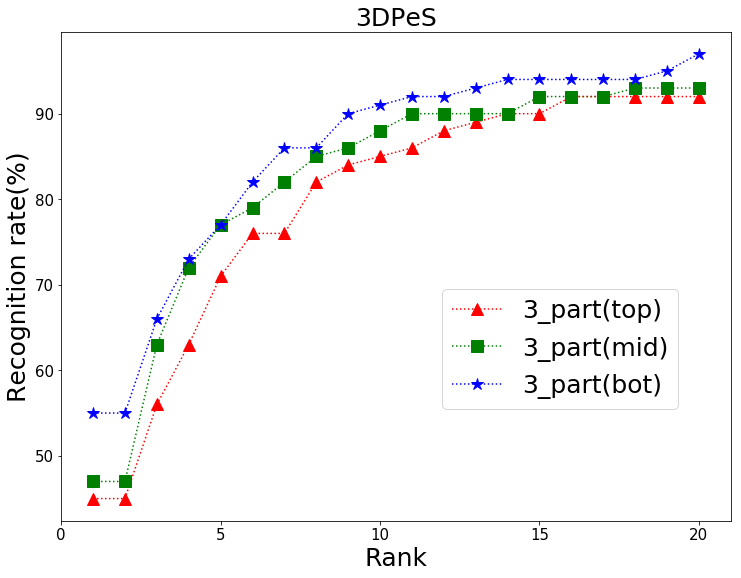

In [6]:
plt.figure(figsize=(12, 9))
plt.plot(range(1,21),sp3_1_PKU,'r^:',markersize=12,label="3_part(top)")
plt.plot(range(1,21),sp3_2_PKU,'gs:',markersize=12,label="3_part(mid)")
plt.plot(range(1,21),sp3_3_PKU,'b*:',markersize=12,label="3_part(bot)")
plt.xlim(0,21)
plt.xticks(range(0,21,5), fontsize = 15)
plt.yticks(fontsize = 15)
#plt.yticks(range(60,100,10))
plt.xlabel('Rank', fontsize = 25)
plt.ylabel('Recognition rate(%)', fontsize = 25)
plt.legend(loc=2,bbox_to_anchor=(0.55, 0.5), fontsize = 25)
plt.title("3DPeS", fontsize = 25)

fig = plt.gcf()
plt.show()

#fig.savefig('3DPeS_result_3p.png', format = 'png')

In [12]:
sp3_1_mk = [55, 55, 63, 66, 68, 70, 73, 74, 75, 77, 78, 78, 79, 79, 79, 80, 80, 80, 80, 81]
sp3_2_mk = [60, 60, 67, 70, 71, 71, 75, 75, 77, 78, 78, 78, 79, 80, 83, 83, 86, 88, 89, 89]
sp3_3_mk = [59, 59, 70, 73, 74, 76, 80, 81, 82, 83, 83, 83, 83, 83, 84, 85, 85, 85, 85, 86]

sp3_1_ch = [91, 91, 93, 97, 97, 97, 98, 98, 98, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100]
sp3_2_ch = [85, 85, 92, 96, 97, 98, 98, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99]
sp3_3_ch = [86, 86, 94, 96, 97, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99]

sp5_1_mk = [51, 51, 59, 65, 69, 70, 72, 74, 75, 77, 78, 78, 79, 81, 81, 83, 83, 84, 85, 85]
sp5_2_mk = [53, 53, 59, 64, 67, 70, 73, 75, 75, 76, 77, 80, 81, 81, 81, 81, 81, 83, 83, 83]
sp5_3_mk = [44, 44, 52, 59, 66, 71, 72, 76, 77, 77, 77, 77, 80, 80, 81, 82, 82, 82, 82, 82]
sp5_4_mk = [50, 50, 60, 67, 70, 76, 77, 78, 79, 79, 79, 80, 80, 81, 82, 84, 84, 85, 85, 85]
sp5_5_mk = [49, 49, 61, 66, 72, 78, 78, 80, 81, 82, 82, 83, 83, 84, 84, 84, 84, 85, 85, 85]

sp5_1_ch = [86, 86, 90, 94, 95, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 97, 98, 98, 98, 98]
sp5_2_ch = [83, 83, 92, 93, 94, 95, 95, 97, 99, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100, 100]
sp5_3_ch = [78, 78, 89, 92, 93, 93, 94, 95, 95, 95, 96, 97, 97, 97, 97, 97, 97, 97, 98, 99]
sp5_4_ch = [86, 86, 91, 96, 97, 97, 97, 98, 98, 98, 99, 99, 99, 99, 99, 99, 99, 99, 100, 100]
sp5_5_ch = [82, 82, 92, 94, 96, 98, 98, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99, 99]

# 3DPeS
ori_3DPeS = [13, 13, 22, 27, 31, 33, 36, 42, 49, 49, 49, 51, 55, 57, 59, 60, 61, 61, 61, 62]
sp3_1_3DPeS = [31, 31, 38, 46, 52, 52, 53, 56, 57, 59, 65, 66, 67, 71, 71, 71, 71, 71, 73, 73]
sp3_2_3DPeS = [13, 13, 20, 29, 32, 35, 36, 38, 39, 41, 43, 46, 46, 48, 50, 52, 55, 56, 56, 56]
sp3_3_3DPeS = [29, 29, 40, 45, 49, 51, 55, 58, 61, 62, 63, 65, 66, 66, 66, 69, 69, 70, 70, 71]

sp5_1_3DPeS = [5, 5, 9, 11, 16, 17, 19, 22, 25, 28, 30, 30, 30, 31, 31, 31, 32, 33, 35, 35]
sp5_2_3DPeS = [17, 17, 24, 32, 42, 50, 53, 53, 54, 57, 62, 64, 66, 66, 66, 66, 67, 69, 71, 71]
sp5_3_3DPeS = [18, 18, 25, 32, 37, 39, 42, 44, 49, 51, 51, 52, 53, 55, 56, 57, 57, 58, 59, 61]
sp5_4_3DPeS = [16, 16, 22, 28, 32, 34, 35, 36, 36, 36, 38, 38, 41, 41, 42, 43, 46, 46, 48, 49]
sp5_5_3DPeS = [20, 20, 28, 38, 42, 46, 49, 52, 53, 54, 57, 58, 60, 61, 61, 62, 63, 64, 66, 66]

a = np.asarray(sp3_1_mk)+np.asarray(sp3_1_ch)+np.asarray(sp3_1_3DPeS)+np.asarray(sp3_1_PKU)
b = np.asarray(sp3_2_mk)+np.asarray(sp3_2_ch)+np.asarray(sp3_2_3DPeS)+np.asarray(sp3_2_PKU)
c = np.asarray(sp3_3_mk)+np.asarray(sp3_3_ch)+np.asarray(sp3_3_3DPeS)+np.asarray(sp3_3_PKU)

# a = np.asarray(sp3_1_ch)+np.asarray(sp3_1_3DPeS)
# b = np.asarray(sp3_2_ch)+np.asarray(sp3_2_3DPeS)
# c = np.asarray(sp3_3_ch)+np.asarray(sp3_3_3DPeS)

#a = np.asarray(sp5_1_mk)+np.asarray(sp5_1_ch)+np.asarray(sp5_1_3DPeS)
#b = np.asarray(sp5_2_mk)+np.asarray(sp5_2_ch)+np.asarray(sp5_2_3DPeS)
#c = np.asarray(sp5_3_mk)+np.asarray(sp5_3_ch)+np.asarray(sp5_3_3DPeS)
#d = np.asarray(sp5_4_mk)+np.asarray(sp5_4_ch)+np.asarray(sp5_4_3DPeS)
#e = np.asarray(sp5_5_mk)+np.asarray(sp5_5_ch)+np.asarray(sp5_5_3DPeS)

#a = np.asarray(sp5_1_ch)+np.asarray(sp5_1_3DPeS)
#b = np.asarray(sp5_2_ch)+np.asarray(sp5_2_3DPeS)
#c = np.asarray(sp5_3_ch)+np.asarray(sp5_3_3DPeS)
#d = np.asarray(sp5_4_ch)+np.asarray(sp5_4_3DPeS)
#e = np.asarray(sp5_5_ch)+np.asarray(sp5_5_3DPeS)

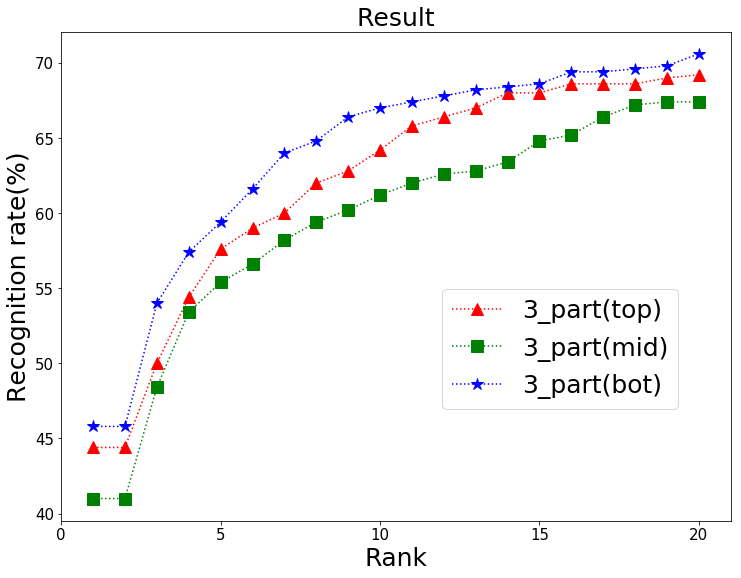

In [14]:
plt.figure(figsize=(12, 9))
plt.plot(range(1,21),a/5,'r^:',markersize=12,label="3_part(top)")
plt.plot(range(1,21),b/5,'gs:',markersize=12,label="3_part(mid)")
plt.plot(range(1,21),c/5,'b*:',markersize=12,label="3_part(bot)")
plt.xlim(0,21)
plt.xticks(range(0,21,5), fontsize = 15)
plt.yticks(fontsize = 15)
#plt.yticks(range(60,100,10))
plt.xlabel('Rank', fontsize = 25)
plt.ylabel('Recognition rate(%)', fontsize = 25)
plt.legend(loc=2,bbox_to_anchor=(0.55, 0.5), fontsize = 25)
plt.title("Result", fontsize = 25)

fig = plt.gcf()
plt.show()
fig.savefig('Result.png', format = 'png')

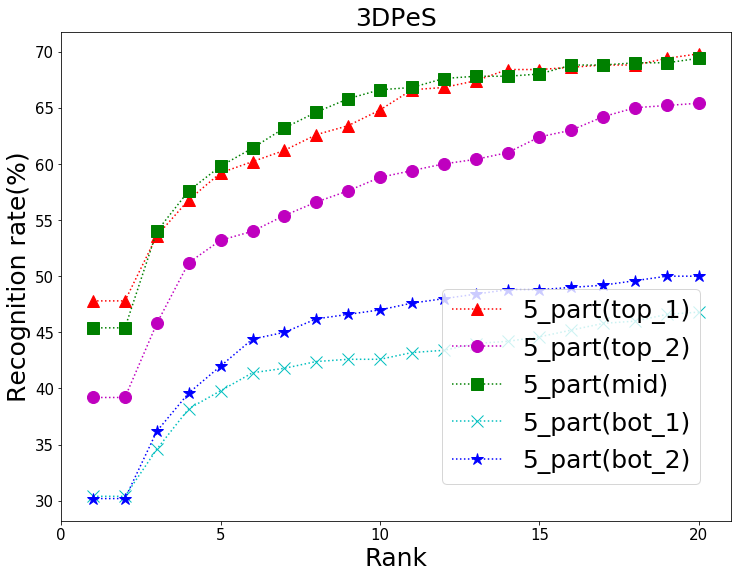

In [41]:
plt.figure(figsize=(12, 9))
plt.plot(range(1,21),a/5,'r^:',markersize=12,label="5_part(top_1)")
plt.plot(range(1,21),b/5,'mo:',markersize=12,label="5_part(top_2)")
plt.plot(range(1,21),c/5,'gs:',markersize=12,label="5_part(mid)")
plt.plot(range(1,21),d/5,'cx:',markersize=12,label="5_part(bot_1)")
plt.plot(range(1,21),e/5,'b*:',markersize=12,label="5_part(bot_2)")
plt.xlim(0,21)
plt.xticks(range(0,21,5), fontsize = 15)
plt.yticks(fontsize = 15)
#plt.yticks(range(60,100,10))
plt.xlabel('Rank', fontsize = 25)
plt.ylabel('Recognition rate(%)', fontsize = 25)
plt.legend(loc=2,bbox_to_anchor=(0.55, 0.5), fontsize = 25)
plt.title("3DPeS", fontsize = 25)

fig = plt.gcf()
plt.show()